# Bayesian inversion of diffusivity in Poisson equation

In [107]:
import sys
import os
import time
import numpy as np
import dolfin as dl

import torch

from scipy.interpolate import griddata

model_path = "../../problems/poisson/"
sys.path.append(model_path)
from poissonModel import PoissonModel

util_path = "../../utilities/"
sys.path.append(util_path)
from plotUtilities import *
from priorSampler import PriorSampler
from fenicsUtilities import vertex_to_function, function_to_vertex
from dataMethods import DataProcessor
from torch_deeponet import DeepONet

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# set seed
seed = 0
np.random.seed(seed)

In [101]:
model_data_folder = model_path + 'data/'
current_directory = os.getcwd()  
results_dir = current_directory + '/Results/'
if not os.path.exists(results_dir):
    os.makedirs(results_dir)

# Plotting functions

In [102]:
def plot_curve(data, x = None, xl = None, yl = None, \
               fs = 20, lw = 2, lclr = 'tab:blue', \
               l_lbl = None, \
               title = None, \
         savefig = False, savefile = '', figsize = [10,10]):
    
    fig, ax = plt.subplots(figsize=figsize)

    if x is not None:
        if l_lbl is not None:
            ax.plot(x, data, lw = lw, color = lclr, label = l_lbl)
        else:
            ax.plot(x, data, lw = lw, color = lclr)
    else:
        ax.plot(data)
    if xl is not None:
        ax.set_xlabel(xl, fontsize = fs)
    if yl is not None:
        ax.set_ylabel(yl, fontsize = fs)

    if l_lbl is not None:
        ax.legend(fontsize = fs, fancybox = True, frameon = True)

    if title is not None:
        ax.set_title(title, fontsize = fs)
        
    plt.tight_layout(pad=0.4)
    if savefig:
        plt.savefig(savefile)
    plt.show()

In [103]:
def plot_fields(mcmc):
    model, prior_sampler, ground_truth_data, x_obs = mcmc.model, mcmc.prior, mcmc.data, mcmc.x_obs

    w_mean = mcmc.tracer.accepted_samples_mean_m
    m_mean = model.transform_gaussian_pointwise(w_mean)
    u_mean = model.solveFwd(u = None, m = m_mean, transform_m = False)

    u_mean_obs = mcmc.state_to_obs(u_mean)

    w_true, m_true, u_true = ground_truth_data['w_true'], ground_truth_data['m_true'], ground_truth_data['u_true'] 
    u_obs = ground_truth_data['u_obs']

    rows, cols = 2, 4
    fig, axs = plt.subplots(rows, cols, figsize=(24, 12))
    axs = np.array([axs]) if rows == 1 else axs

    uvec = [[w_true, m_true, u_true], \
            [w_mean, m_mean, u_mean]]
    title_vec = [[r'$w_{true} \sim N(0, C)$', r'$m_{true} = a\, \exp(w_{true}) + b$', r'$u_{true} = F(m_{true})$', r'$u_{obs}$'], \
                [r'$w_{mean} \sim N(0, C)$', r'$m_{mean} = a\, \exp(w_{mean}) + b$', r'$u_{mean} = F(m_{mean})$', r'$u_{mean, obs}$']]
    cmap_vec = [['magma', 'jet', 'viridis', 'copper'] for i in range(rows)]
    sup_title = r'Ground truth $(w, m, u(m), u_{obs})$ and posterior mean $(w, m, u(m), u_{obs})$'
    fs = 25
    y_sup_title = 1.075
    savefilename = mcmc.tracer.savepath + 'true_and_posterior_mean_w_m_u.png'

    nodes = model.Vm.mesh().coordinates()


    for i in range(rows):
        for j in range(cols):

            # add grid points
            if j == cols - 1:
                axs[i,j].set_xlim([-0.1, 1.1])
                axs[i,j].set_ylim([-0.1, 1.1])
            
            if j < cols - 1:
                cbar = field_plot(axs[i,j], \
                    uvec[i][j], \
                    nodes, cmap = cmap_vec[i][j])
            else:
                uob = u_obs if i == 0 else u_mean_obs
                cbar = point_plot(axs[i,j], uob, x_obs, cmap = cmap_vec[i][j])
            divider = make_axes_locatable(axs[i,j])
            cax = divider.append_axes('right', size='8%', pad=0.03)
            cax.tick_params(labelsize=fs)
            cbar = fig.colorbar(cbar, cax=cax, orientation='vertical')
            if j < cols - 1:
                axs[i,j].axis('off')
            if title_vec is not None:
                axs[i,j].set_title(title_vec[i][j], fontsize=fs, pad=10)        

    fig.tight_layout()
    if sup_title is not None:
        fig.suptitle(sup_title, fontsize=1.25*fs, y = y_sup_title)
    if savefilename is not None:
        plt.savefig(savefilename,  bbox_inches='tight')
    plt.show()

# Create PoissonModel

In [104]:
# set diffusivity in prior covariance
def modify_diffusivity(u, V):
    coords = V.mesh().coordinates()
    centers = np.array([[0.25, 0.75, 0.2, 0.5], [0.65, 0.45, 0.25, 0.2]])
    for i in range(coords.shape[0]):
        x, y = coords[i,0] , coords[i,1]
        for j in range(centers.shape[0]):
            dx, dy = x - centers[j,0], y - centers[j,1]
            if dx*dx + dy*dy < centers[j,2]*centers[j,2]:
                u[i] = centers[j,3]
                # we don't want to set the value again
                break
        else:
            u[i] = 10
    return u

In [105]:
gamma = 0.005
delta = 0.2
logn_scale = 1
logn_translate = 0.
nx, ny = 50, 50
fe_order = 1
data_prefix = 'Poisson'

# create mesh
mesh = dl.UnitSquareMesh(nx, ny)

# create function spaces
Vm = dl.FunctionSpace(mesh, 'Lagrange', fe_order)
Vu = Vm

# create prior sampler
prior_sampler = PriorSampler(Vm, gamma, delta, seed)

# set diffusion in prior
prior_diffusion = function_to_vertex(prior_sampler.diffusion_fn)
prior_diffusion = modify_diffusivity(prior_diffusion, prior_sampler.V)
prior_sampler.set_diffusivity(prior_diffusion)

# create model
model = PoissonModel(Vm, Vu, prior_sampler, logn_scale, logn_translate, seed)

# Load Neural Operators

## DeepONet

In [ ]:
# load the data
deeponet_data = DataProcessor(model_path + 'data/' + data_prefix + '_samples.npz', num_train = 3400, num_test = 600, num_inp_fn_points = 2601, num_out_fn_points = 2601, num_Y_components = 1)

# load the model
deeponet = torch.load(model_path \
                + 'DeepONet/Results_implement2/DeepONet/model.pkl')

print('Model:', model)

%%time
m1 = model.samplePrior(transform_m = True)
m2 = m1.copy()

%%time
u_dn = deeponet_data.decode_Y(deeponet.predict(deeponet_data.encode_X(m1), deeponet_data.X_trunk).detach().numpy())

%%time
u_model = model.solveFwd(u = None, m = m2, transform_m = False)

Model: <poissonModel.PoissonModel object at 0x7449097ee610>


/tmp/ipykernel_1328082/1799807879.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  deeponet = torch.load(model_path \


array([-0.01260531, -0.01446855, -0.01352918, ..., -0.02848387,
       -0.05350161, -0.08555675], dtype=float32)

# Get ground truth

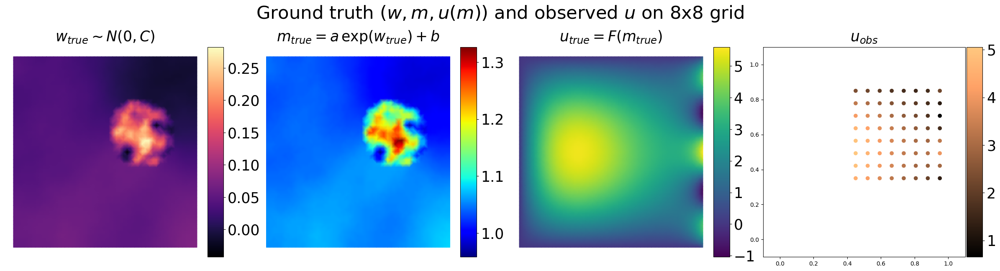

In [90]:
# load
ground_truth_data = np.load(results_dir + 'ground_truth/data.npz')
num_grid_x, num_grid_y = ground_truth_data['num_grid_x'], ground_truth_data['num_grid_y']
w_true = ground_truth_data['w_true']
m_true = ground_truth_data['m_true']
u_true = ground_truth_data['u_true']
x_obs = ground_truth_data['x_obs']
u_obs = ground_truth_data['u_obs']


rows, cols = 1, 4
fig, axs = plt.subplots(rows, cols, figsize=(24, 6))
axs = np.array([axs]) if rows == 1 else axs

uvec = [[w_true, m_true, u_true]]
title_vec = [[r'$w_{true} \sim N(0, C)$', r'$m_{true} = a\, \exp(w_{true}) + b$', r'$u_{true} = F(m_{true})$', r'$u_{obs}$']]
cmap_vec = [['magma', 'jet', 'viridis', 'copper']]
sup_title = r'Ground truth $(w, m, u(m))$ and observed $u$ on {}x{} grid'.format(num_grid_x, num_grid_y)
fs = 25
y_sup_title = 1.075
savefilename = results_dir + 'true_and_obs_w_m_u.png'

nodes = model.Vm.mesh().coordinates()


for i in range(rows):
    for j in range(cols):

        # add grid points
        if j == cols - 1:
            axs[i,j].set_xlim([-0.1, 1.1])
            axs[i,j].set_ylim([-0.1, 1.1])
        
        if j < cols - 1:
            cbar = field_plot(axs[i,j], \
                uvec[i][j], \
                nodes, cmap = cmap_vec[i][j])
        else:
            cbar = point_plot(axs[i,j], u_obs, x_obs, cmap = cmap_vec[i][j])
        divider = make_axes_locatable(axs[i,j])
        cax = divider.append_axes('right', size='8%', pad=0.03)
        cax.tick_params(labelsize=fs)
        cbar = fig.colorbar(cbar, cax=cax, orientation='vertical')
        if j < cols - 1:
            axs[i,j].axis('off')
        if title_vec is not None:
            axs[i,j].set_title(title_vec[i][j], fontsize=fs, pad=10)        

fig.tight_layout()
if sup_title is not None:
    fig.suptitle(sup_title, fontsize=1.25*fs, y = y_sup_title)
if savefilename is not None:
    plt.savefig(savefilename,  bbox_inches='tight')
plt.show()

## Compute noise

In [91]:
u_obs_mean, u_obs_std = np.mean(u_obs), np.std(u_obs)
sigma_noise = 0.005 * u_obs_mean
print('u_obs_mean = {:.3e}, u_obs_std = {:.3e}, sigma_noise: {:.3e}'.format(u_obs_mean, u_obs_std, sigma_noise))

u_obs_mean = 3.055e+00, u_obs_std = 1.030e+00, sigma_noise: 1.528e-02


# Bayesian parameter estimation setup

In [114]:
# Create an MCMC class that takes model, prior, and data and
# model -> provides a method solveFwd() that solves the forward problem for a input m
# prior -> provides a method logPrior() that returns the log prior
# data -> provides the observations and the points at which observations are made
# The class then implements the following functions
# solveFwd(self, m) -> solves the forward problem for a given m
# logLikelihood(self, m) -> returns the log-likelihood (i.e., cost or misfit)
# logPosterior(self, m) -> returns the log posterior (cost + log-prior)
# sample(self,m) -> generate next sample given the current sample (modifies m if needed)
# proposal(self, m) -> returns the next sample given the current sample (does not modify m)
# run(self) -> runs the MCMC algorithm usign Metroplis-Hastings together with preconditioned Crank-Nicolson
# save(self) -> saves the samples, log-likelihood, log-posterior, and the chain and prints the details such as cost, acceptances, etc.

class State:

    def __init__(self, m_dim, u_dim, u_obs_dim):
        self.m = np.zeros(m_dim)
        self.u = np.zeros(u_dim)
        self.u_obs_dim = u_obs_dim
        self.u_obs = np.zeros(u_obs_dim)
        self.err_obs = np.zeros(u_obs_dim)
        self.log_likelihood = 0
        self.log_posterior = 0
        self.log_prior = 0
        self.cost = 0

    def set(self, a):
        self.m = a.m.copy()
        self.u = a.u.copy()
        self.u_obs = a.u_obs.copy()
        self.err_obs = a.err_obs.copy()
        self.log_likelihood = a.log_likelihood
        self.log_posterior = a.log_posterior
        self.log_prior = a.log_prior
        self.cost = a.cost

class Tracer:

    def __init__(self, mcmc):
        self.mcmc = mcmc

        
        self.accepted_samples_m = np.zeros((1, self.mcmc.m_dim))
        self.accepted_samples_u = np.zeros((1, self.mcmc.u_dim))

        self.accepted_samples_mean_m = np.zeros(self.mcmc.m_dim)
        self.accepted_samples_std_m = np.zeros(self.mcmc.m_dim)
        self.accepted_samples_mean_u = np.zeros(self.mcmc.u_dim)
        self.accepted_samples_std_u = np.zeros(self.mcmc.u_dim)
        
        self.accepted_samples_obs_u = np.zeros((1, self.mcmc.u_obs_dim))
        self.accepted_samples_obs_mean_u = np.zeros(self.mcmc.u_obs_dim)
        self.accepted_samples_obs_err = np.zeros((1, self.mcmc.u_obs_dim))
        self.accepted_samples_obs_err_mean = np.zeros(self.mcmc.u_obs_dim)

        self.accepted_samples_log_likelihood = np.zeros(1)
        self.accepted_samples_log_posterior = np.zeros(1)
        self.accepted_samples_log_prior = np.zeros(1)
        self.accepted_samples_cost = np.zeros(1)

        self.accepted_samples_log_likelihood_mean = 0
        self.accepted_samples_log_posterior_mean = 0
        self.accepted_samples_log_prior_mean = 0
        self.accepted_samples_cost_mean = 0
        
        self.current_acceptance_rate = 0
        self.acceptances = 0
        self.acceptance_rate = np.zeros(1)
        self.accep_reject_record = np.zeros(1)

        self.append_sample_i = 0

        # save related
        self.savepath = results_dir
        self.savefilename = self.savepath + 'mcmc_results.npz'
        self.save_every = 10
        self.statistics_every = 10

        # logging
        self.print_every = 10
        self.print_lvl = 1
        self.display_plot_every = self.print_every

    def init(self, current):
        self.accepted_samples_m[0] = current.m
        self.accepted_samples_u[0] = current.u
        self.accepted_samples_obs_u[0] = current.u_obs
        self.accepted_samples_obs_err[0] = current.err_obs
        self.accepted_samples_log_likelihood[0] = current.log_likelihood
        self.accepted_samples_log_posterior[0] = current.log_posterior
        self.accepted_samples_log_prior[0] = current.log_prior
        self.accepted_samples_cost[0] = current.cost

    def stats(self):
        # compute statistics
        self.accepted_samples_mean_m = np.mean(self.accepted_samples_m, axis = 0)
        self.accepted_samples_std_m = np.std(self.accepted_samples_m, axis = 0)
        self.accepted_samples_mean_u = np.mean(self.accepted_samples_u, axis = 0)
        self.accepted_samples_std_u = np.std(self.accepted_samples_u, axis = 0)
        self.accepted_samples_obs_mean_u = np.mean(self.accepted_samples_obs_u, axis = 0)
        self.accepted_samples_obs_err_mean = np.mean(self.accepted_samples_obs_err, axis = 0)
        
        self.accepted_samples_log_likelihood_mean = np.mean(self.accepted_samples_log_likelihood)
        self.accepted_samples_log_posterior_mean = np.mean(self.accepted_samples_log_posterior)
        self.accepted_samples_log_prior_mean = np.mean(self.accepted_samples_log_prior)
        self.accepted_samples_cost_mean = np.mean(self.accepted_samples_cost)


    def append(self, i, current, accept, force_save = False):

        # if we have seen i before, then we will not modify the data but we may need to save if force_save is True
        if i < self.append_sample_i:
            if force_save:
                # update stats
                self.stats()
                # save
                self.save()
            return
        
        self.append_sample_i = i        
        
        # update acceptances
        if accept == 1:
            self.acceptances += 1

        # append new data
        self.current_acceptance_rate = self.acceptances / (i + 1)
        self.acceptance_rate = np.append(self.acceptance_rate, self.current_acceptance_rate)
        self.accep_reject_record = np.append(self.accep_reject_record, accept)

        self.accepted_samples_m = np.vstack((self.accepted_samples_m, current.m))
        self.accepted_samples_u = np.vstack((self.accepted_samples_u, current.u))
        self.accepted_samples_obs_u = np.vstack((self.accepted_samples_obs_u, current.u_obs))
        self.accepted_samples_obs_err = np.vstack((self.accepted_samples_obs_err, current.err_obs))

        self.accepted_samples_log_likelihood = np.append(self.accepted_samples_log_likelihood, current.log_likelihood)
        self.accepted_samples_log_posterior = np.append(self.accepted_samples_log_posterior, current.log_posterior)
        self.accepted_samples_log_prior = np.append(self.accepted_samples_log_prior, current.log_prior)
        self.accepted_samples_cost = np.append(self.accepted_samples_cost, current.cost)
        
        # stats?
        if i % self.statistics_every == 0: 
            self.stats()

        # save?
        if i % self.save_every == 0:
            self.save()

    def save(self):
        np.savez(self.savefilename, \
            accepted_samples_m = self.accepted_samples_m, \
            accepted_samples_u = self.accepted_samples_u, \
            accepted_samples_obs_u = self.accepted_samples_obs_u, \
            accepted_samples_obs_err = self.accepted_samples_obs_err, \
            accepted_samples_log_likelihood = self.accepted_samples_log_likelihood, \
            accepted_samples_log_posterior = self.accepted_samples_log_posterior, \
            accepted_samples_log_prior = self.accepted_samples_log_prior, \
            accepted_samples_cost = self.accepted_samples_cost, \
            accepted_samples_mean_m = self.accepted_samples_mean_m, \
            accepted_samples_std_m = self.accepted_samples_std_m, \
            accepted_samples_mean_u = self.accepted_samples_mean_u, \
            accepted_samples_std_u = self.accepted_samples_std_u, \
            accepted_samples_obs_mean_u = self.accepted_samples_obs_mean_u, \
            accepted_samples_obs_err_mean = self.accepted_samples_obs_err_mean, \
            accepted_samples_log_likelihood_mean = self.accepted_samples_log_likelihood_mean, \
            accepted_samples_log_posterior_mean = self.accepted_samples_log_posterior_mean, \
            accepted_samples_log_prior_mean = self.accepted_samples_log_prior_mean, \
            accepted_samples_cost_mean = self.accepted_samples_cost_mean, \
            current_acceptance_rate = self.current_acceptance_rate, \
            acceptance_rate = self.acceptance_rate, \
            acceptances = self.acceptances, \
            accep_reject_record = self.accep_reject_record, \
            pcn_beta = self.mcmc.pcn_beta, \
            sigma_noise = self.mcmc.sigma_noise, \
            seed = self.mcmc.seed, \
            n_samples = self.mcmc.n_samples, \
            n_burnin = self.mcmc.n_burnin)
        


class MCMC:
    def __init__(self, model, prior, data, sigma_noise, pcn_beta = 0.2, seed = 0):
        
        # model class that provides solveFwd()
        self.model = model
        self.m_dim = self.model.m_dim
        self.u_dim = self.model.u_dim

        self.u_nodes = self.model.u_nodes
        
        # prior class that provides () and logPrior()
        self.prior = prior

        # data (dict) that provides x_obs, u_obs, m_true, u_true, etc.
        self.data = data

        # noise (std-dev) in the observations
        self.sigma_noise = sigma_noise

        # preconditioned Crank-Nicolson beta --> proposal = beta * new_sample + (1-beta^2)^(1/2) * current 
        self.pcn_beta = pcn_beta

        # seed
        self.seed = seed
        
        # unpack data
        self.x_obs = data['x_obs']
        self.grid_x_obs = data['grid_x']
        self.grid_y_obs = data['grid_y']
        self.u_obs = data['u_obs']
        self.u_obs_dim = len(self.x_obs)
        self.w_true = data['w_true']
        self.m_true = data['m_true']
        self.u_true = data['u_true']

        # current and proposed input parameter and state variables
        self.current = State(self.m_dim, self.u_dim, self.u_obs_dim)
        self.proposed = State(self.m_dim, self.u_dim, self.u_obs_dim)

        # tracer
        self.tracer = Tracer(self) 

        # store mcmc parameters
        self.n_samples = 0
        self.n_burnin = 0

        # surrogate models
        self.surrogate_models = []
        self.surrogate_data = []
        self.surrogate_to_use = None

    def solveFwd(self, current):
        if self.surrogate_to_use is not None:
            if self.surrogate_to_use == 'DeepONet':
                current.u = self.surrogate_models[0].predict(current.m, self.surrogate_data[0].X_trunk).detach().numpy()
        else:
            current.u = self.model.solveFwd(u = current.u, m = current.m, transform_m = True)
        return current.u
    
    def state_to_obs(self, u):
        return griddata(self.u_nodes, u, self.x_obs, method='linear')
    
    def logLikelihood(self, current):
        current.u = self.solveFwd(current)
        current.u_obs = self.state_to_obs(current.u)
        current.err_obs = current.u_obs - self.u_obs
        current.cost = 0.5 * np.linalg.norm(current.err_obs)**2 / self.sigma_noise**2
        current.log_likelihood = -current.cost

        return current.log_likelihood
    
    def logPosterior(self, current):
        current.log_prior = self.prior.logPrior(current.m)
        current.log_likelihood = self.logLikelihood(current)
        current.log_posterior = current.log_prior + current.log_likelihood
        return current.log_posterior
    
    def proposal(self, current, proposed):
        # preconditioned Crank-Nicolson
        # self.prior.get() returns the new sample
        proposed.m, proposed.log_prior = self.prior(proposed.m)
        return self.pcn_beta * proposed.m + np.sqrt(1 - self.pcn_beta**2) * current.m
    
    def sample(self, current):
        # compute the proposed state
        self.proposed.m = self.proposal(current, self.proposed)
        self.proposed.log_likelihood= self.logPosterior(self.proposed)
        
        # accept or reject (based on log-likelihood, i.e., -cost, for preconditioned Crank Nicholson following Stuart 2010 and HippyLib)
        alpha = current.cost - self.proposed.cost # or -current.log_likelihood + self.proposed.log_likelihood
        # alpha = self.proposed.log_prior + self.proposed.log_likelihood - current.log_prior - current.log_likelihood
        
        if alpha > np.log(np.random.uniform()):
            current.set(self.proposed)
            return 1

        return 0
    
    def run(self, init_m = None, n_samples = 1000, n_burnin = 100, \
            pcn_beta = None, sigma_noise = None, \
            savepath = None, savefilename = None, \
            save_every = None, print_every = None, \
            print_lvl = None, display_plot_every = None):
        
        self.n_samples = n_samples
        self.n_burnin = n_burnin
        if pcn_beta is not None:
            self.pcn_beta = pcn_beta
        if sigma_noise is not None:
            self.sigma_noise = sigma_noise
        if savepath is not None:
            self.tracer.savepath = savepath
            self.tracer.savefilename = self.tracer.savepath + self.tracer.savefilename
        if savefilename is not None:
            self.tracer.savefilename = self.tracer.savepath + savefilename
        if save_every is not None:
            self.tracer.save_every = save_every
        if print_every is not None:
            self.tracer.print_every = print_every
        if display_plot_every is not None:
            self.tracer.display_plot_every = display_plot_every
        if print_lvl is not None:
            self.tracer.print_lvl = print_lvl

        # sampling time
        start_time = time.perf_counter()
        t = time.perf_counter()

        # initialize the current state
        if init_m is not None:
            self.current.m = init_m
        else:
            self.current.m, self.current.log_prior = self.prior(self.current.m)

        self.current.log_posterior = self.logPosterior(self.current)
        if self.tracer.print_lvl > 1:
            print('initializing the current state. Initial cost: {:.3e}'.format(self.current.cost)) 

        # initial state
        # self.tracer.init(self.current)

        print('-'*50)
        print('MCMC started with {} samples and {} burnin'.format(n_samples, n_burnin))
        print('-'*50)
        # run the MCMC
        init_done = False
        for i in range(n_samples + n_burnin):

            # sample
            accept = self.sample(self.current)

            # print?
            if i % self.tracer.print_every == 0 and self.tracer.print_lvl > 0:
                dt = time.perf_counter() - t
                t = time.perf_counter()
                print('-'*50)
                if i < n_burnin:
                    print('Burnin: {:4d}, Cost: {:.3e}'.format(i, self.current.cost))
                else:
                    print('Sample: {:4d}, Accepted samples: {:4d}, Acceptance Rate: {:.3e}, Cost mean: {:.3e}. \nWalking {} number of samples took {:.3e}s'.format(i, \
                            self.tracer.acceptances, \
                            self.tracer.current_acceptance_rate, \
                            self.tracer.accepted_samples_cost_mean, self.tracer.print_every, dt))
                print('-'*50)
            
            if i > n_burnin and i % self.tracer.display_plot_every == 0:
                self.plot()

            if i < n_burnin:
                continue
            
            # append
            if not init_done:
                self.tracer.init(self.current)
                init_done = True
            self.tracer.append(i, self.current, accept)

        # save the final state
        self.tracer.append(i, self.current, accept, force_save=True)

        # print final message
        end_time = time.perf_counter()
        print('-'*50)
        print('MCMC finished in {:.3e}s. \nTotal samples: {:4d}, Accepted samples: {:4d}, Acceptance Rate: {:.3e}, Cost mean: {:.3e}'.format(end_time - start_time, n_samples + n_burnin, self.tracer.acceptances, self.tracer.current_acceptance_rate, self.tracer.accepted_samples_cost_mean))
        print('-'*50)

    def plot(self):
        # plot the results
        if self.tracer.acceptances < 10:
            return 

        # cost
        plot_curve(self.tracer.accepted_samples_cost, xl=r'Samples', \
            yl= r'Cost = $-\log(\pi_{like}(u_{obs} | w))$', \
            fs = 20, lw = 3, \
            savefig = True, \
            savefile = self.tracer.savepath + 'cost.png', \
            figsize=[6,4])
        
        # acceptance rate
        plot_curve(self.tracer.acceptance_rate, xl=r'Samples', \
            yl= r'Acceptance rate', \
            fs = 20, lw = 3, \
            savefig = True, \
            savefile = self.tracer.savepath + 'acceptance_rate.png', \
            figsize=[6,4])

        # compare true and posterior mean fields
        plot_fields(self)


In [116]:
mcmc = MCMC(model, prior_sampler, ground_truth_data, \
            sigma_noise = sigma_noise, pcn_beta = 0.2, \
            seed = seed)

mcmc.surrogate_models = [deeponet]
mcmc.surrogate_data = [deeponet_data]
mcmc.surrogate_to_use = 'DeepONet'

initializing the current state. Initial cost: 1.352e+06
--------------------------------------------------
MCMC started with 4000 samples and 100 burnin
--------------------------------------------------
--------------------------------------------------
Burnin:    0, Cost: 1.349e+06
--------------------------------------------------
--------------------------------------------------
Burnin:   50, Cost: 1.000e+06
--------------------------------------------------
--------------------------------------------------
Sample:  100, Accepted samples:    0, Acceptance Rate: 0.000e+00, Cost mean: 0.000e+00. 
Walking 50 number of samples took 1.450e+01s
--------------------------------------------------
--------------------------------------------------
Sample:  150, Accepted samples:    2, Acceptance Rate: 1.333e-02, Cost mean: 8.800e+05. 
Walking 50 number of samples took 1.539e+01s
--------------------------------------------------
--------------------------------------------------
Sample:  

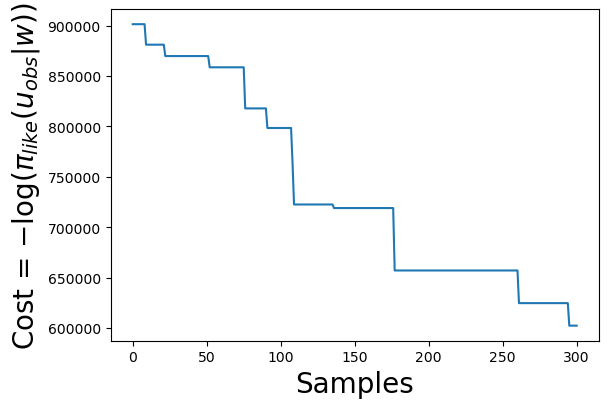

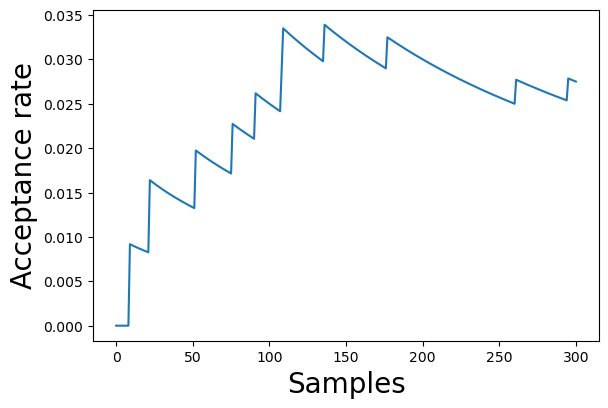

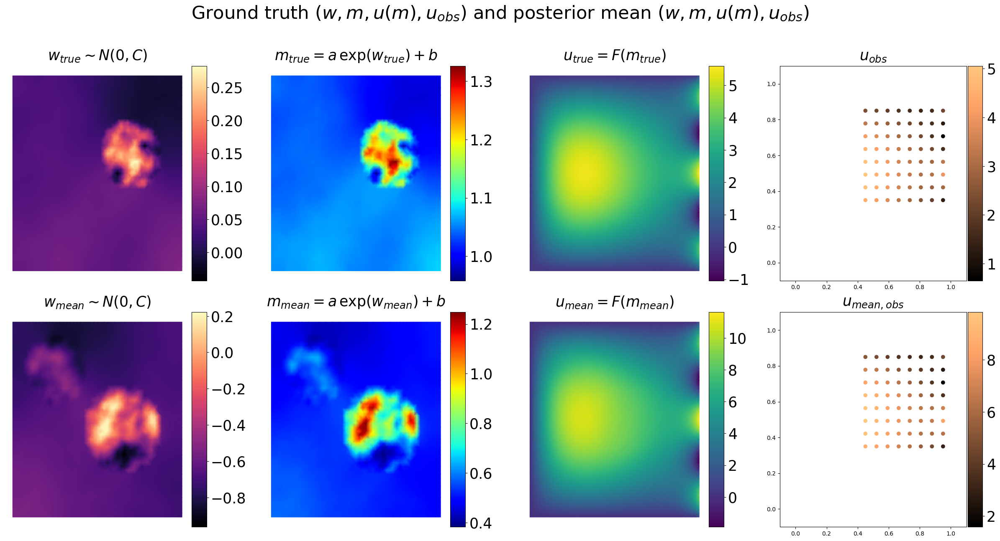

--------------------------------------------------
Sample:  450, Accepted samples:   11, Acceptance Rate: 2.444e-02, Cost mean: 7.210e+05. 
Walking 50 number of samples took 2.209e+01s
--------------------------------------------------


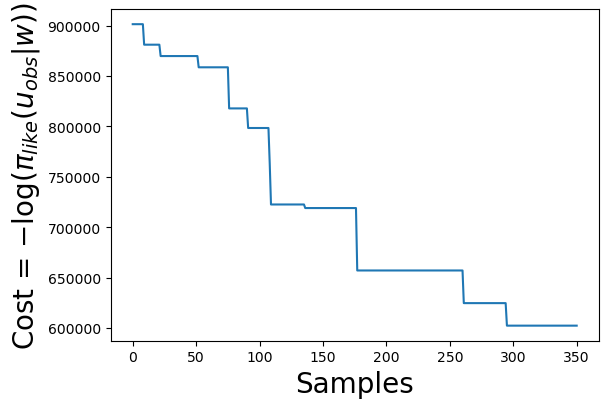

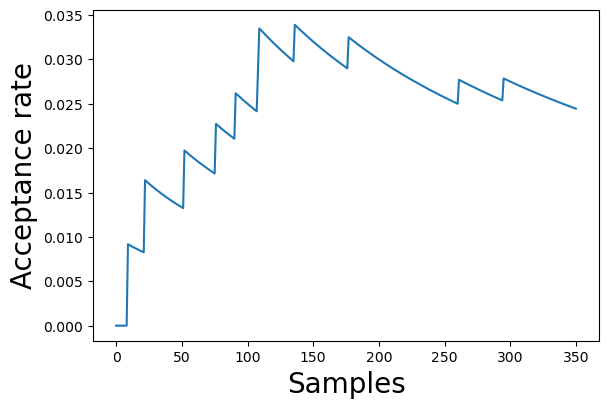

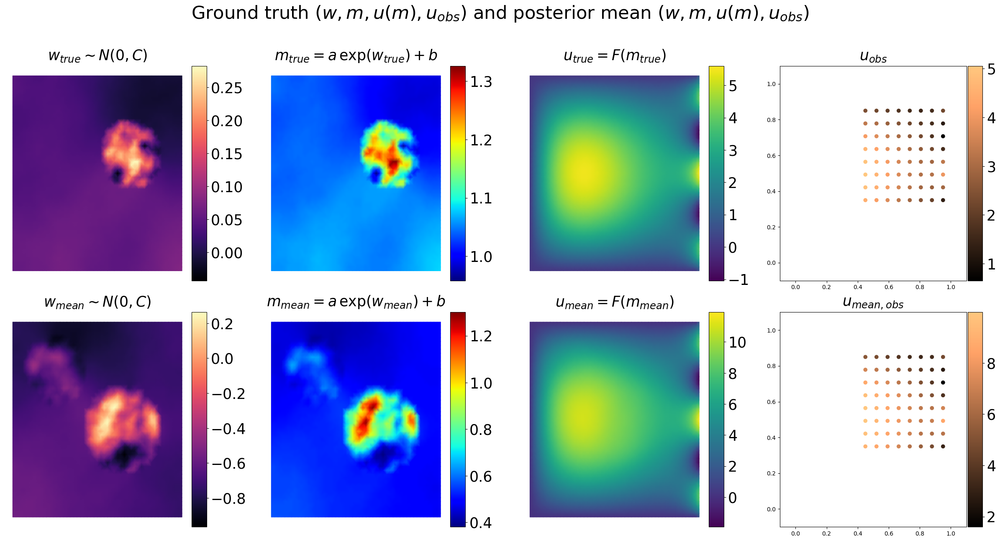

--------------------------------------------------
Sample:  500, Accepted samples:   12, Acceptance Rate: 2.400e-02, Cost mean: 7.056e+05. 
Walking 50 number of samples took 1.789e+01s
--------------------------------------------------


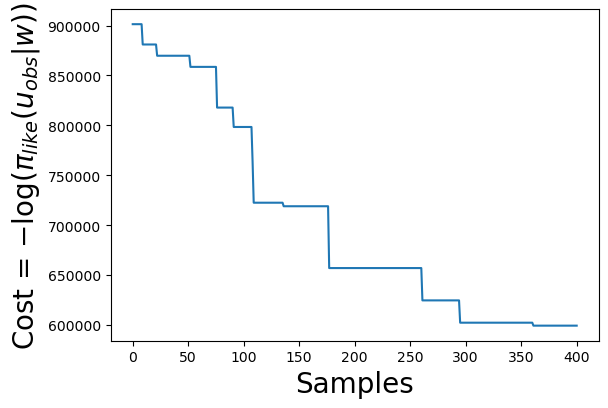

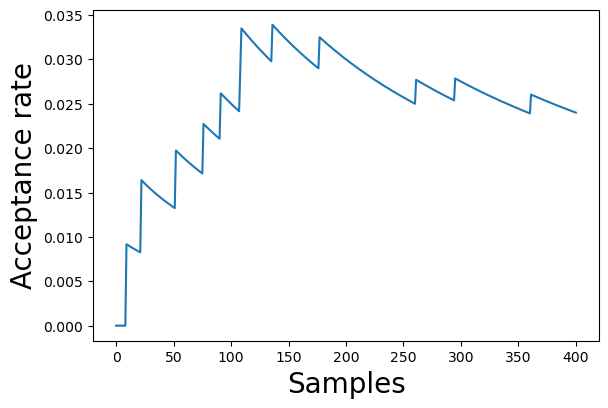

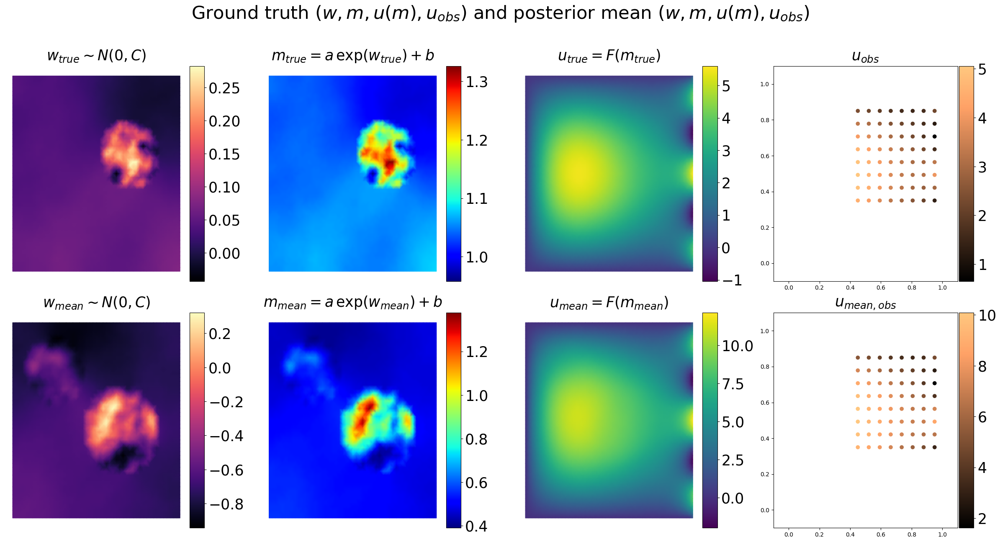

--------------------------------------------------
Sample:  550, Accepted samples:   12, Acceptance Rate: 2.182e-02, Cost mean: 6.936e+05. 
Walking 50 number of samples took 2.089e+01s
--------------------------------------------------


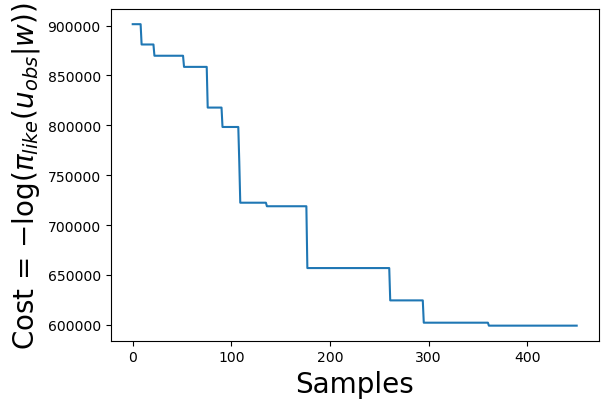

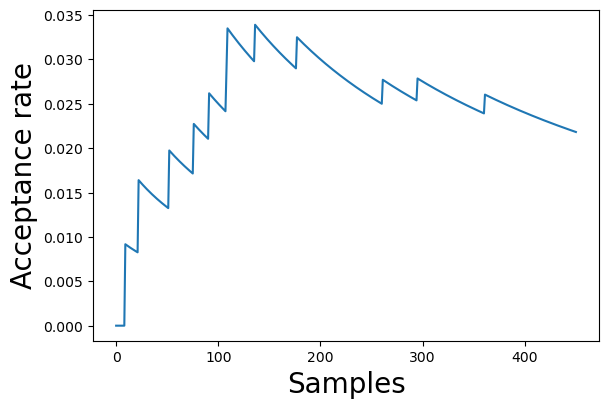

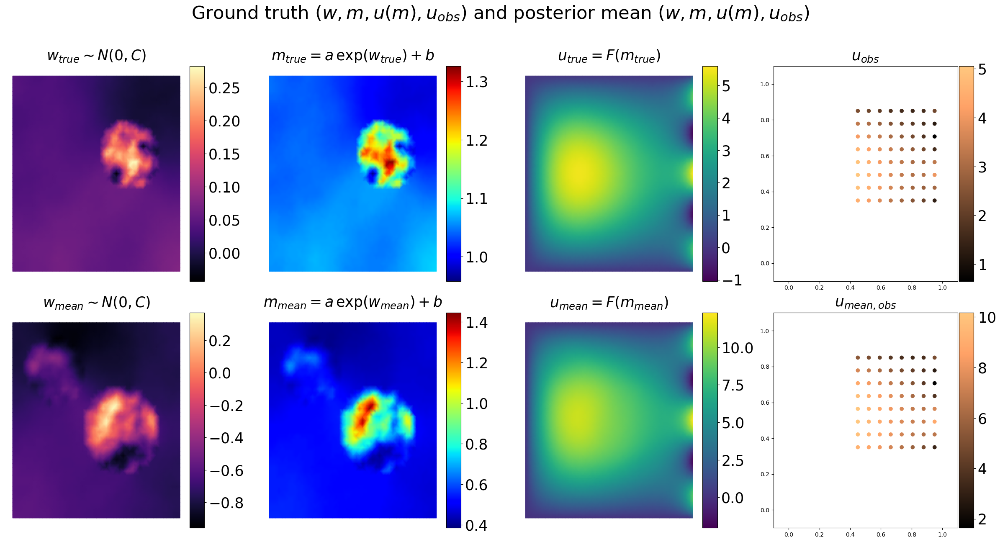

--------------------------------------------------
Sample:  600, Accepted samples:   12, Acceptance Rate: 2.000e-02, Cost mean: 6.840e+05. 
Walking 50 number of samples took 1.963e+01s
--------------------------------------------------


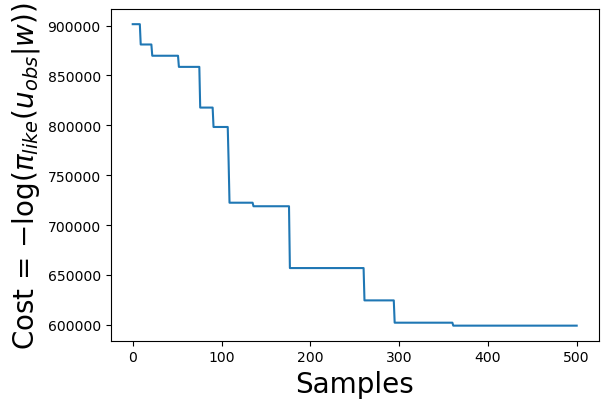

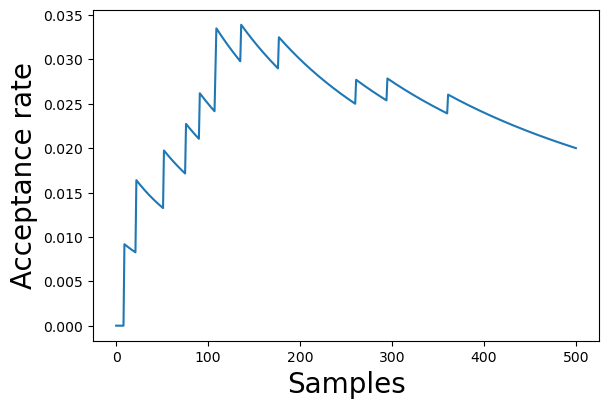

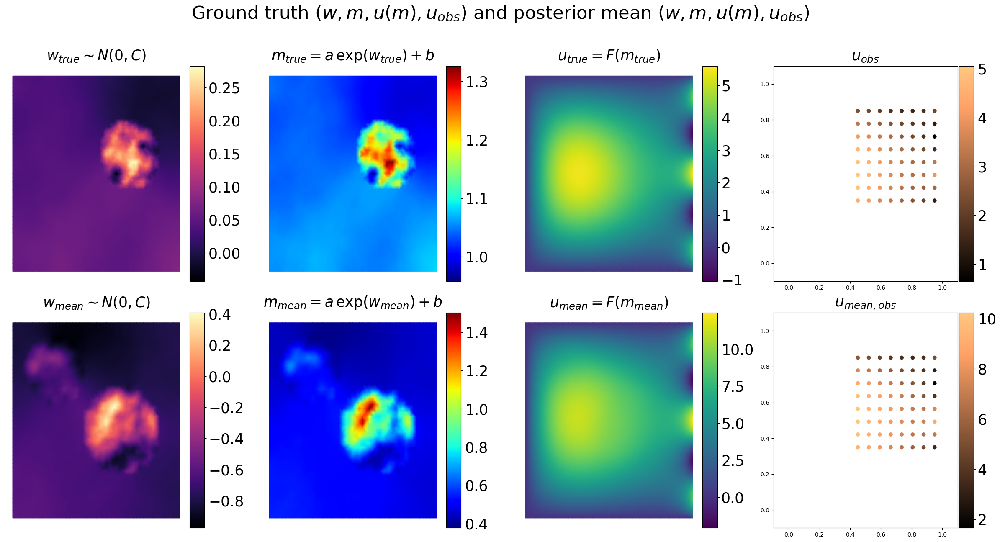

--------------------------------------------------
Sample:  650, Accepted samples:   13, Acceptance Rate: 2.000e-02, Cost mean: 6.738e+05. 
Walking 50 number of samples took 2.058e+01s
--------------------------------------------------


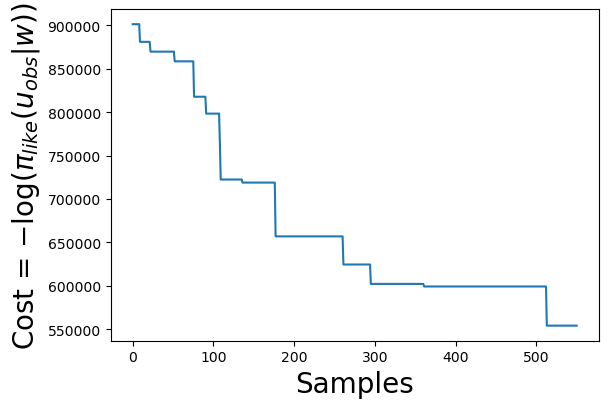

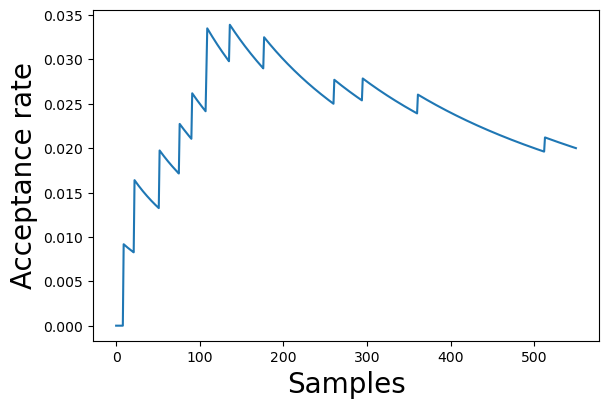

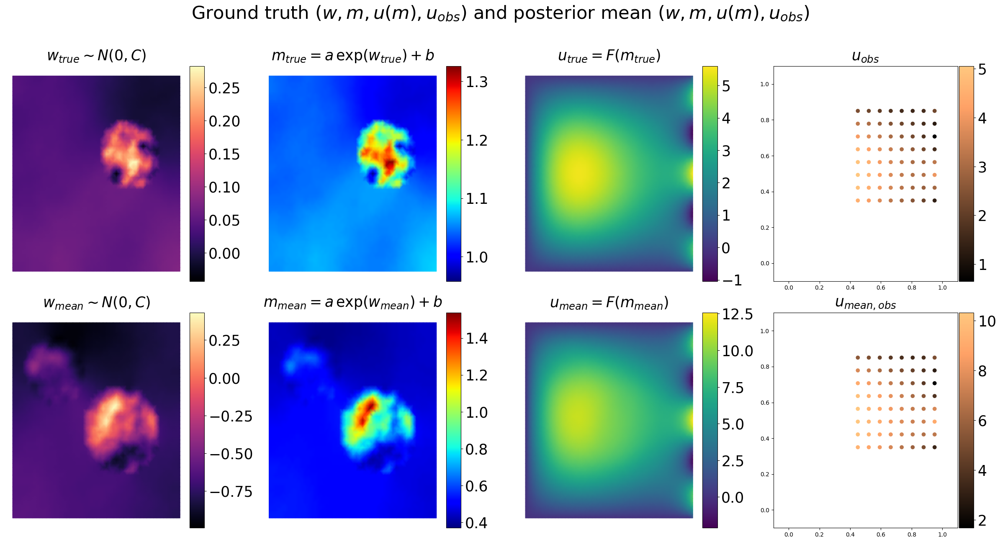

--------------------------------------------------
Sample:  700, Accepted samples:   15, Acceptance Rate: 2.143e-02, Cost mean: 6.625e+05. 
Walking 50 number of samples took 2.145e+01s
--------------------------------------------------


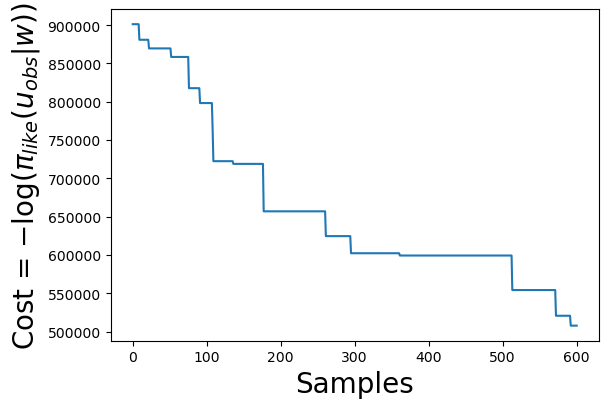

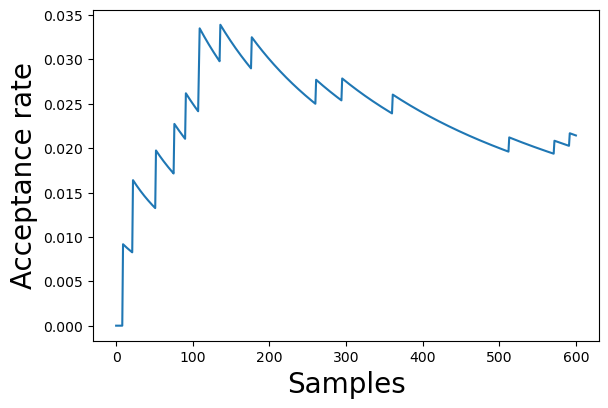

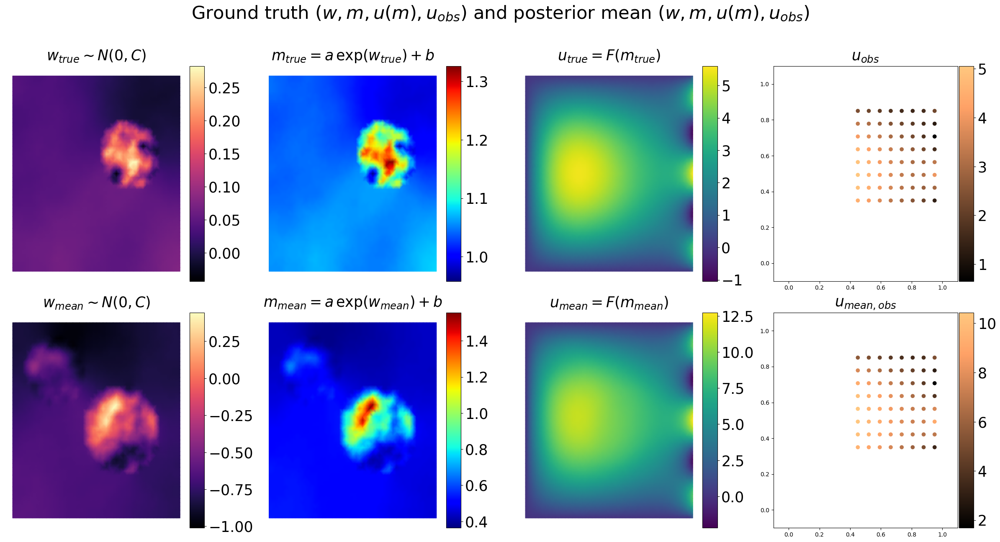

--------------------------------------------------
Sample:  750, Accepted samples:   16, Acceptance Rate: 2.133e-02, Cost mean: 6.503e+05. 
Walking 50 number of samples took 2.031e+01s
--------------------------------------------------


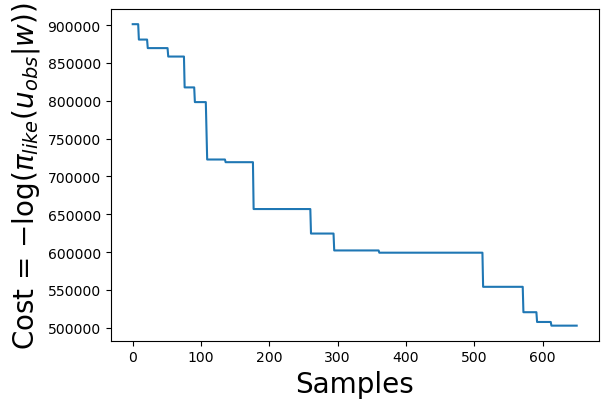

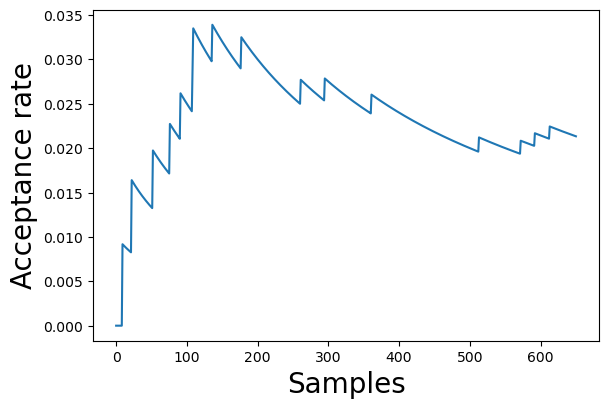

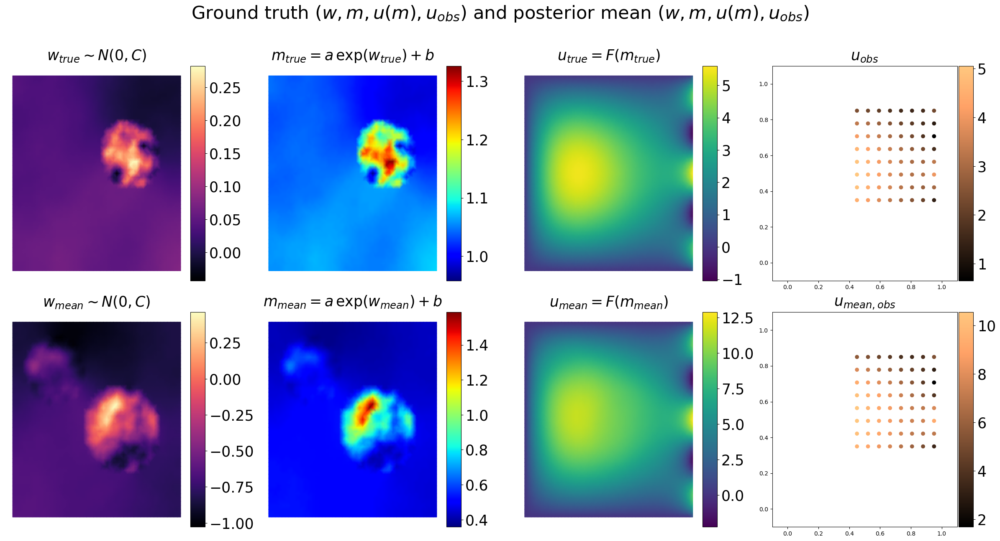

--------------------------------------------------
Sample:  800, Accepted samples:   16, Acceptance Rate: 2.000e-02, Cost mean: 6.396e+05. 
Walking 50 number of samples took 2.113e+01s
--------------------------------------------------


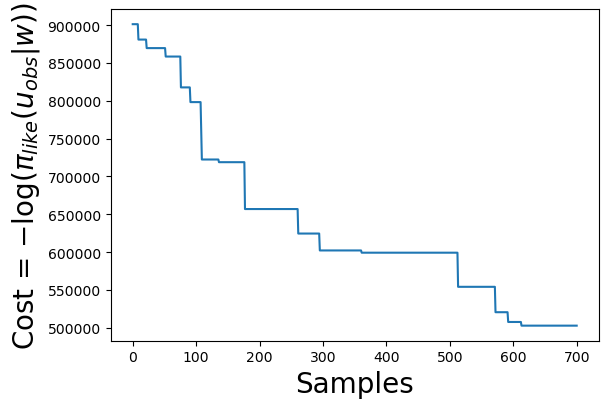

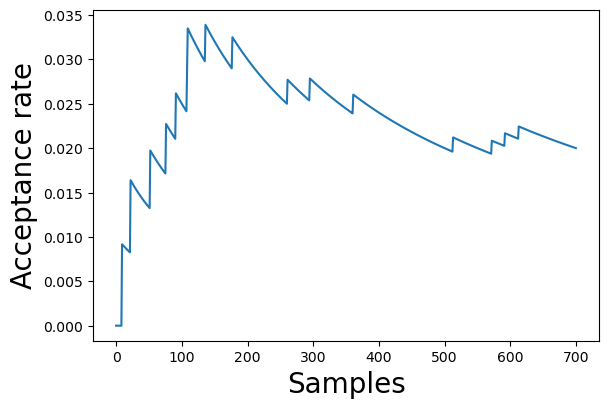

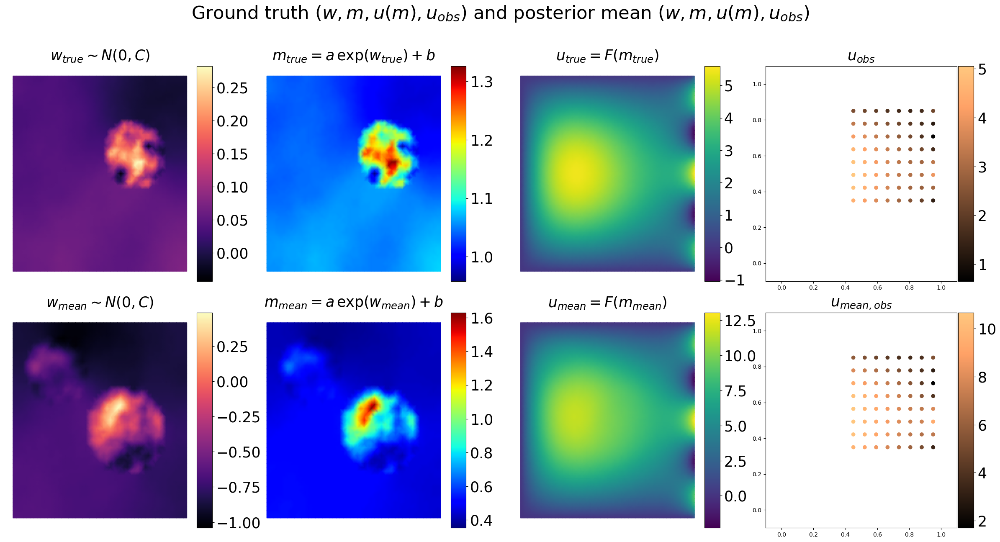

--------------------------------------------------
Sample:  850, Accepted samples:   17, Acceptance Rate: 2.000e-02, Cost mean: 6.303e+05. 
Walking 50 number of samples took 2.088e+01s
--------------------------------------------------


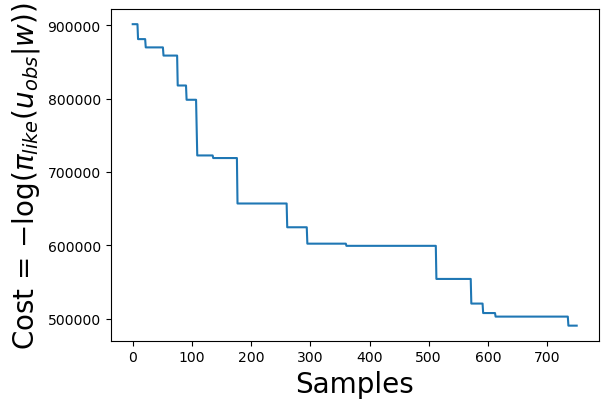

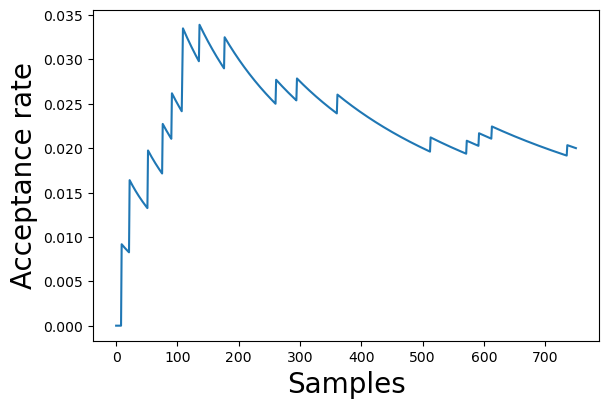

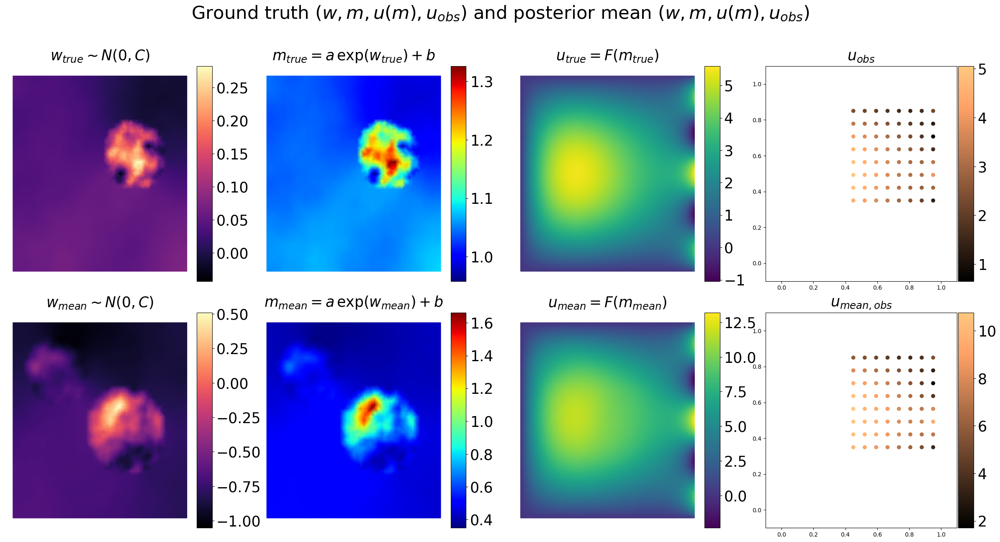

--------------------------------------------------
Sample:  900, Accepted samples:   18, Acceptance Rate: 2.000e-02, Cost mean: 6.215e+05. 
Walking 50 number of samples took 2.180e+01s
--------------------------------------------------


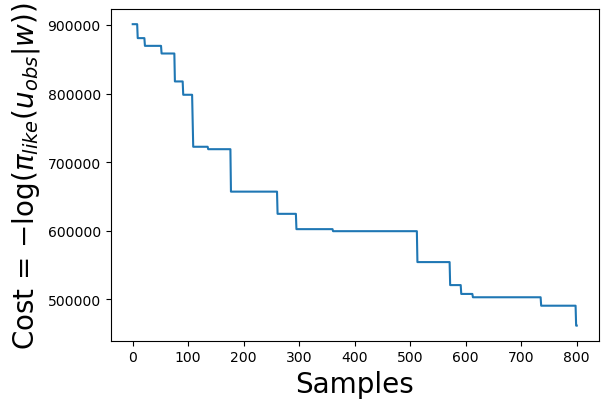

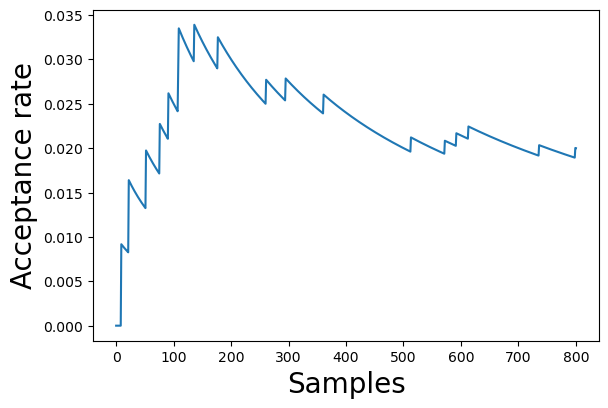

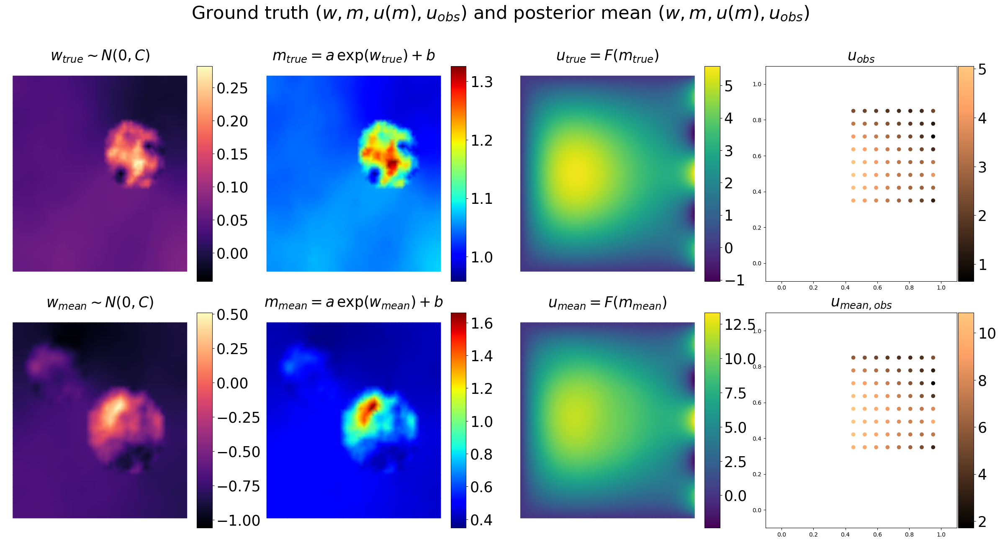

--------------------------------------------------
Sample:  950, Accepted samples:   18, Acceptance Rate: 1.895e-02, Cost mean: 6.122e+05. 
Walking 50 number of samples took 2.014e+01s
--------------------------------------------------


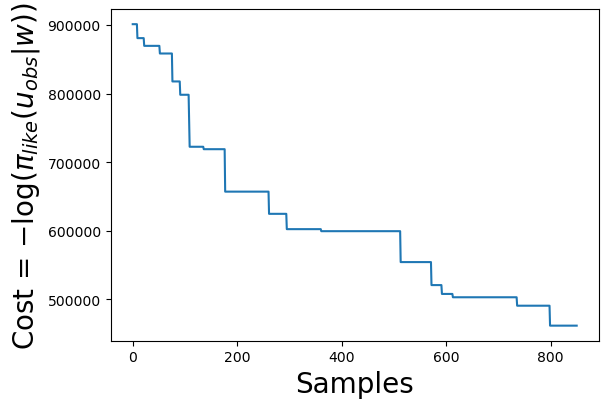

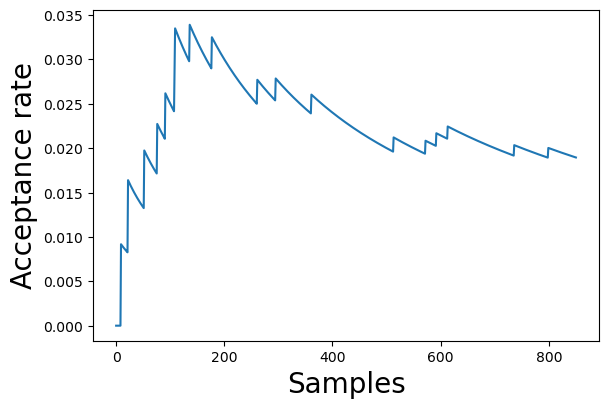

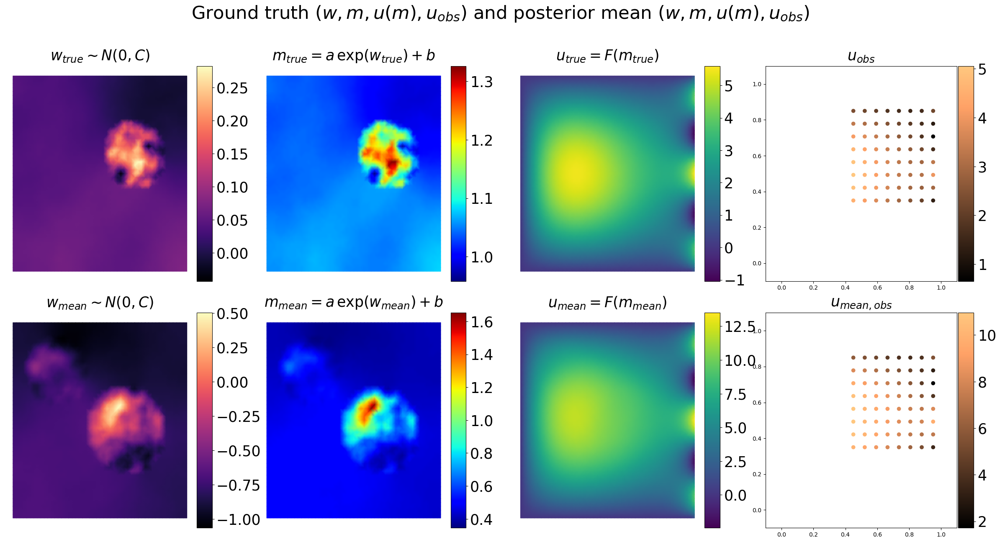

--------------------------------------------------
Sample: 1000, Accepted samples:   20, Acceptance Rate: 2.000e-02, Cost mean: 6.024e+05. 
Walking 50 number of samples took 2.034e+01s
--------------------------------------------------


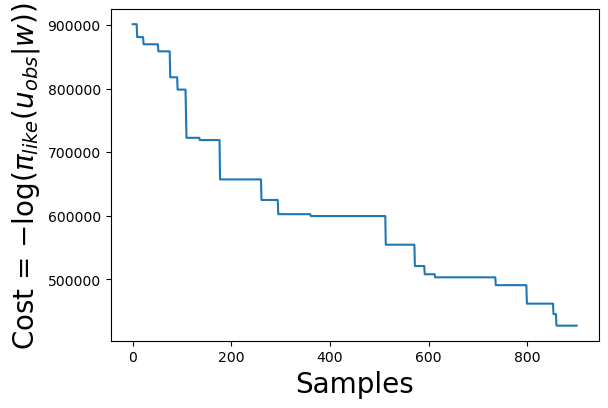

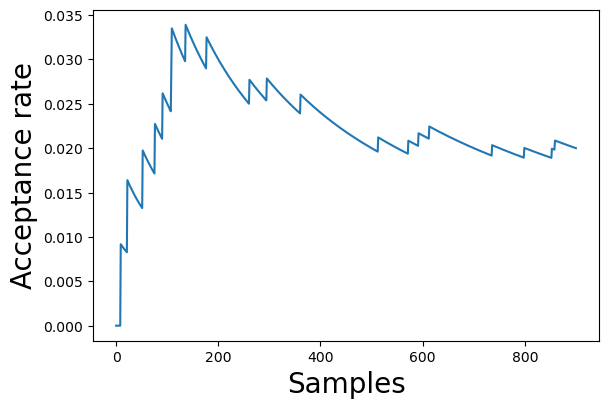

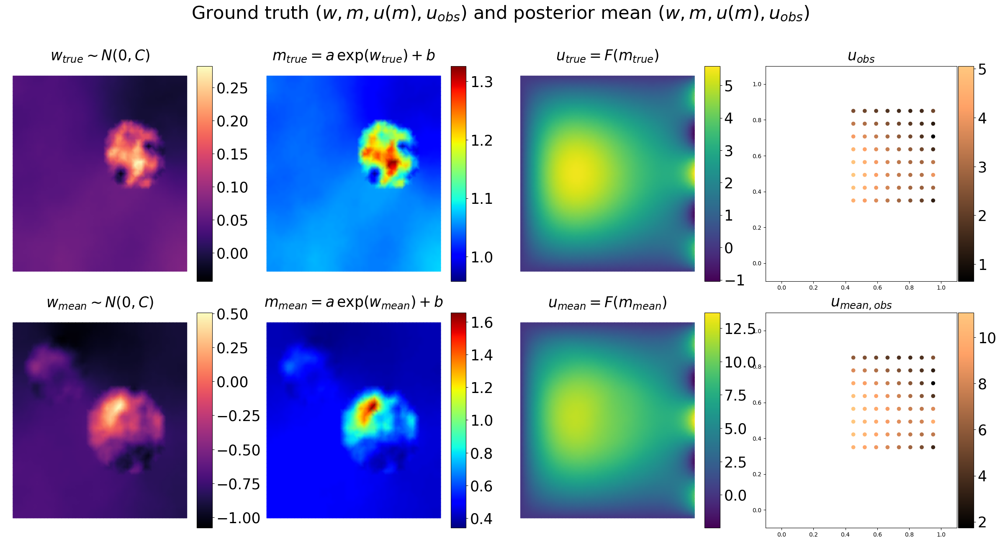

--------------------------------------------------
Sample: 1050, Accepted samples:   20, Acceptance Rate: 1.905e-02, Cost mean: 5.930e+05. 
Walking 50 number of samples took 1.950e+01s
--------------------------------------------------


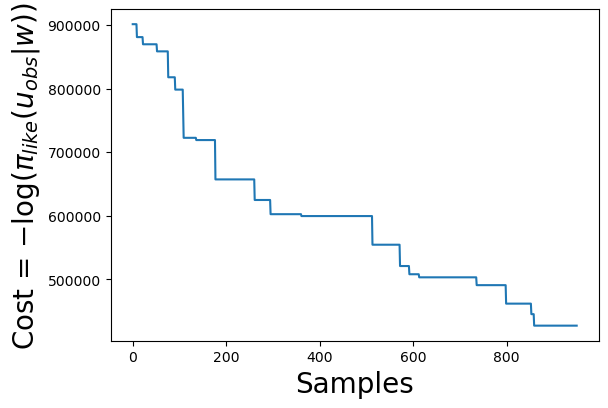

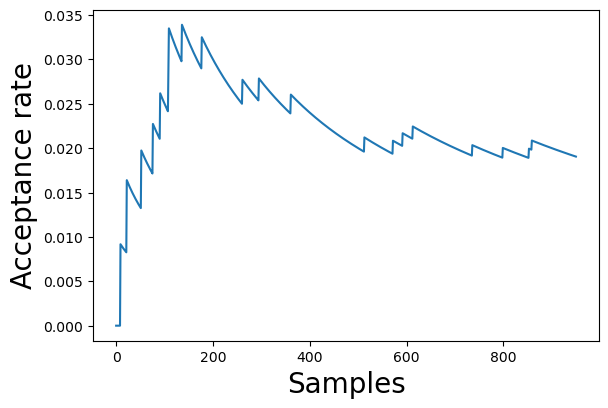

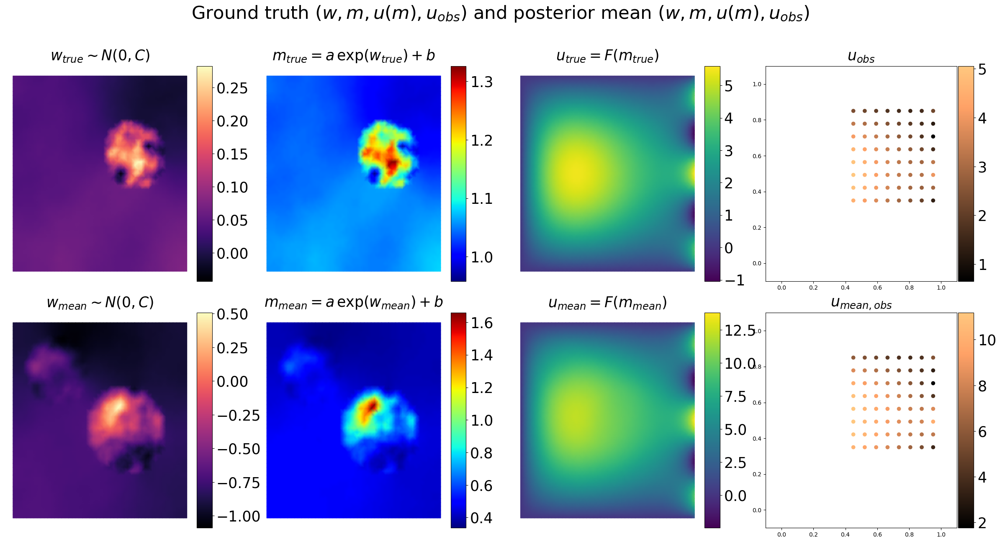

--------------------------------------------------
Sample: 1100, Accepted samples:   21, Acceptance Rate: 1.909e-02, Cost mean: 5.846e+05. 
Walking 50 number of samples took 2.048e+01s
--------------------------------------------------


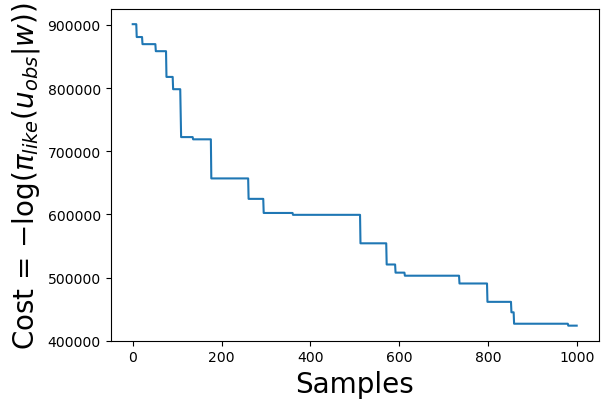

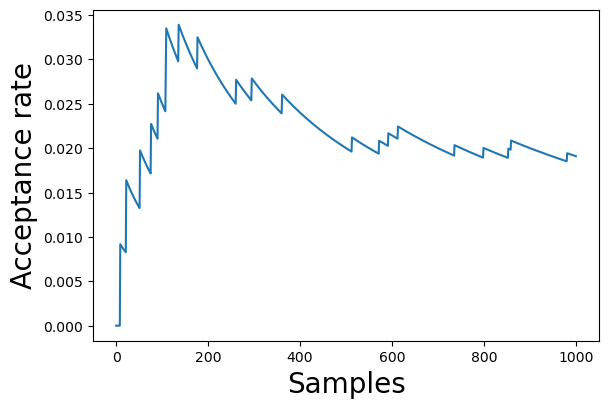

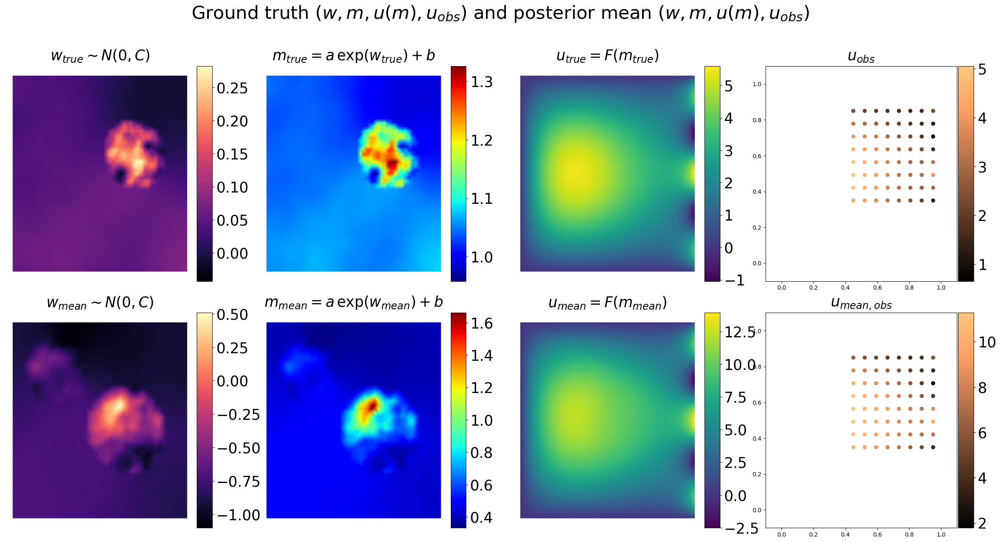

--------------------------------------------------
Sample: 1150, Accepted samples:   21, Acceptance Rate: 1.826e-02, Cost mean: 5.769e+05. 
Walking 50 number of samples took 2.012e+01s
--------------------------------------------------


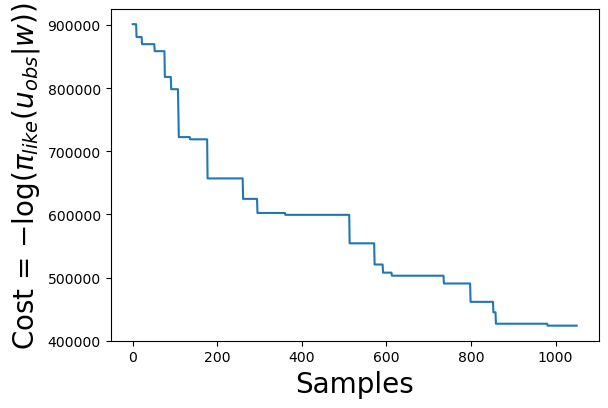

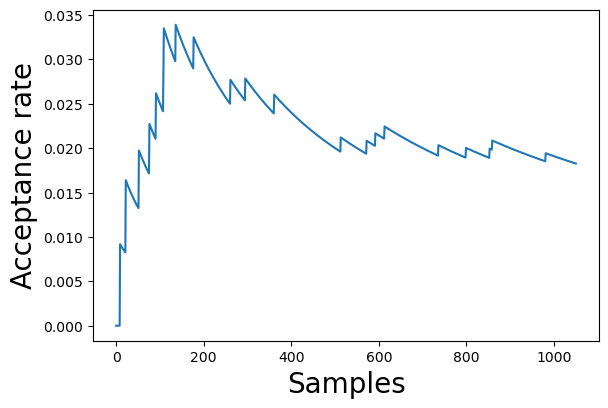

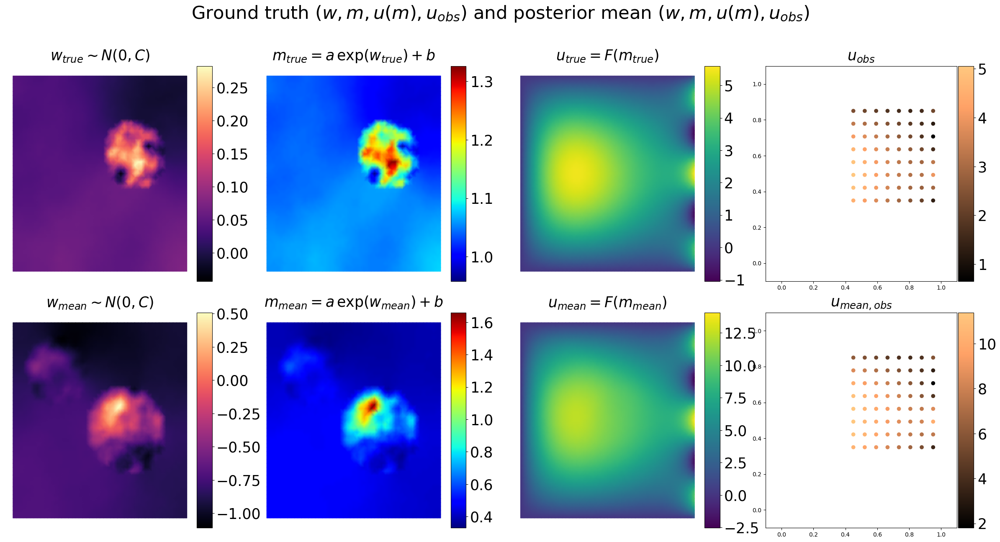

--------------------------------------------------
Sample: 1200, Accepted samples:   22, Acceptance Rate: 1.833e-02, Cost mean: 5.696e+05. 
Walking 50 number of samples took 1.999e+01s
--------------------------------------------------


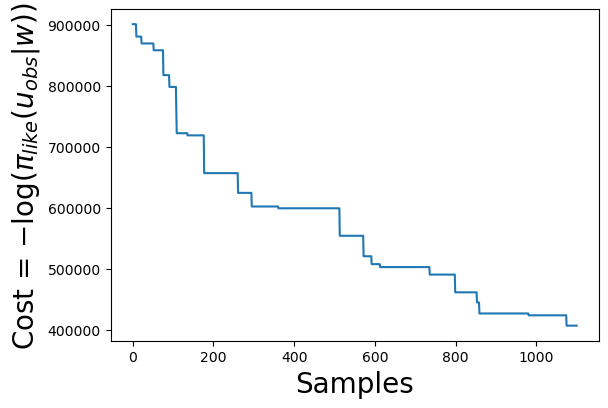

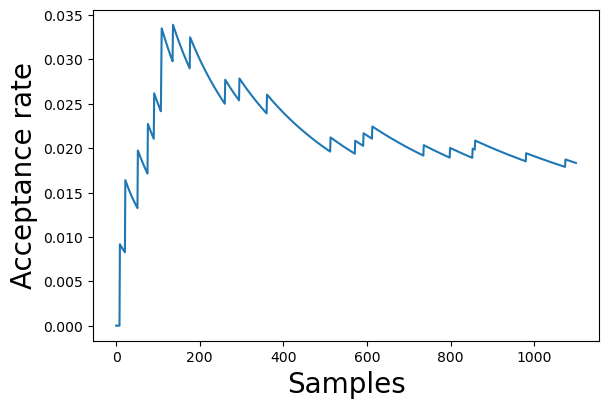

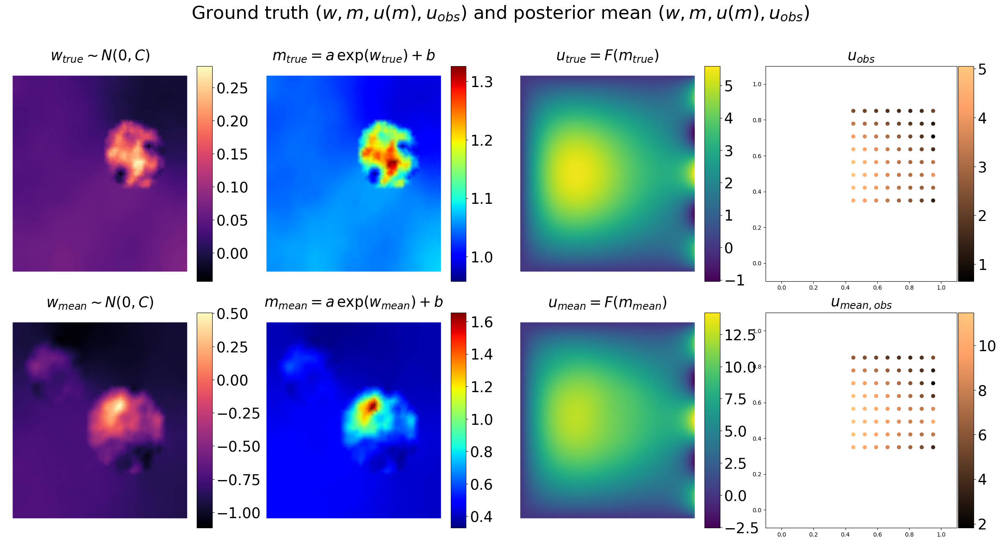

--------------------------------------------------
Sample: 1250, Accepted samples:   23, Acceptance Rate: 1.840e-02, Cost mean: 5.622e+05. 
Walking 50 number of samples took 2.062e+01s
--------------------------------------------------


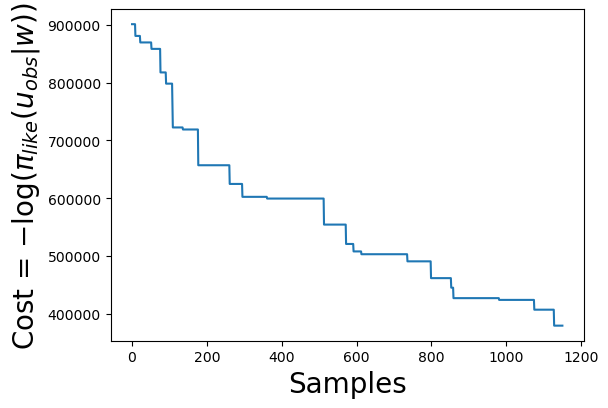

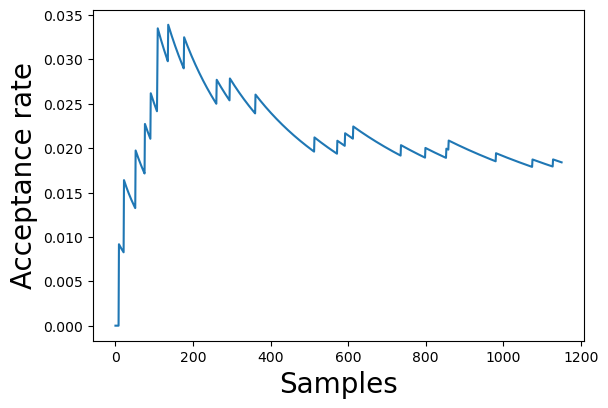

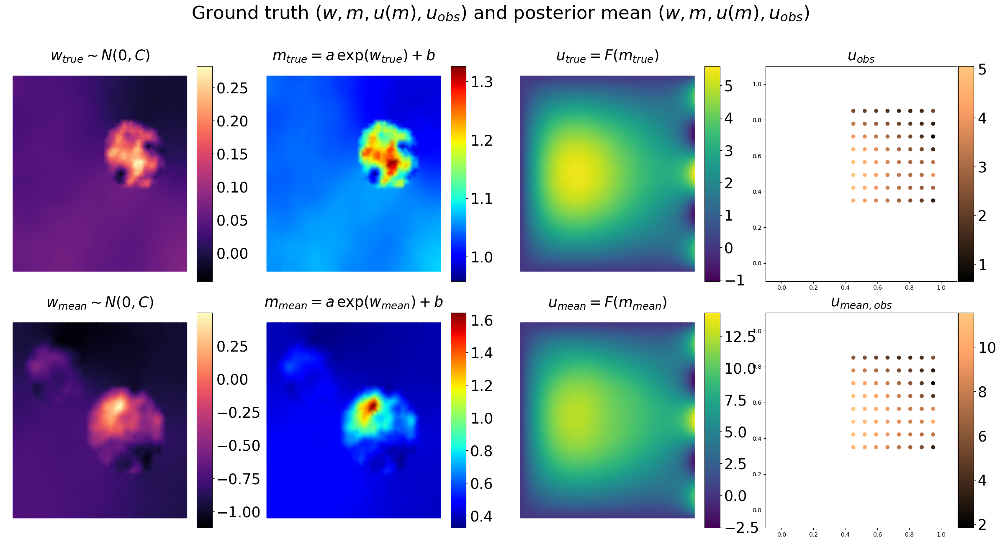

--------------------------------------------------
Sample: 1300, Accepted samples:   23, Acceptance Rate: 1.769e-02, Cost mean: 5.545e+05. 
Walking 50 number of samples took 1.935e+01s
--------------------------------------------------


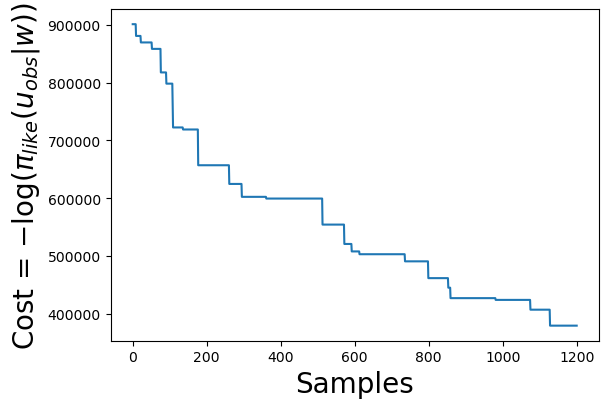

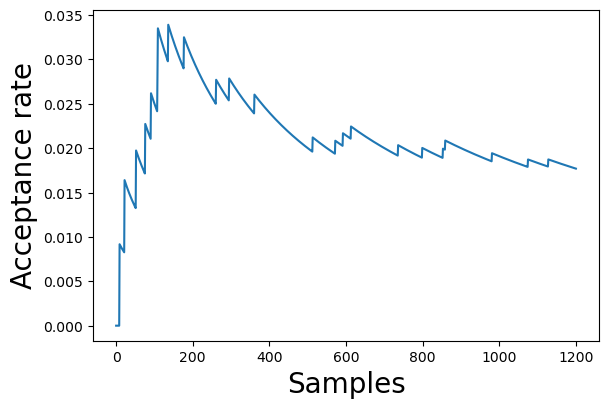

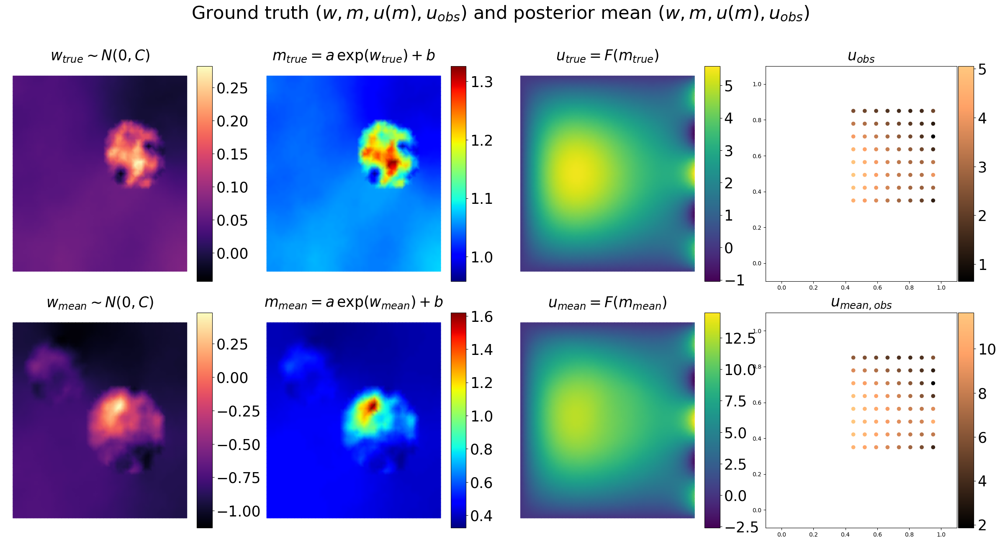

--------------------------------------------------
Sample: 1350, Accepted samples:   23, Acceptance Rate: 1.704e-02, Cost mean: 5.474e+05. 
Walking 50 number of samples took 2.121e+01s
--------------------------------------------------


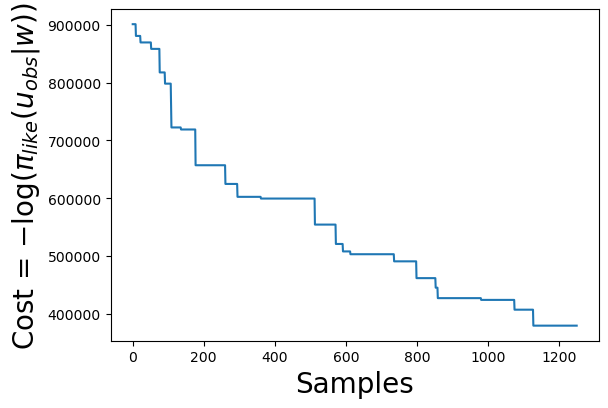

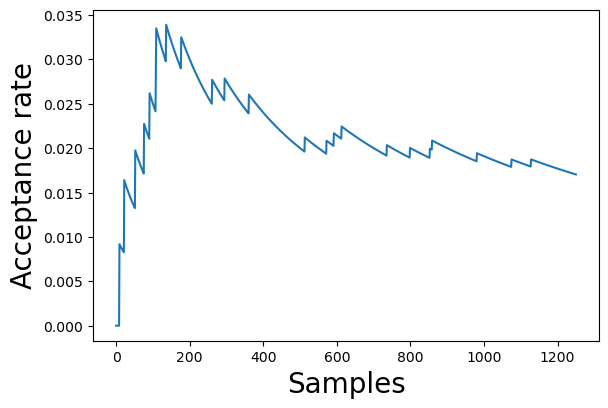

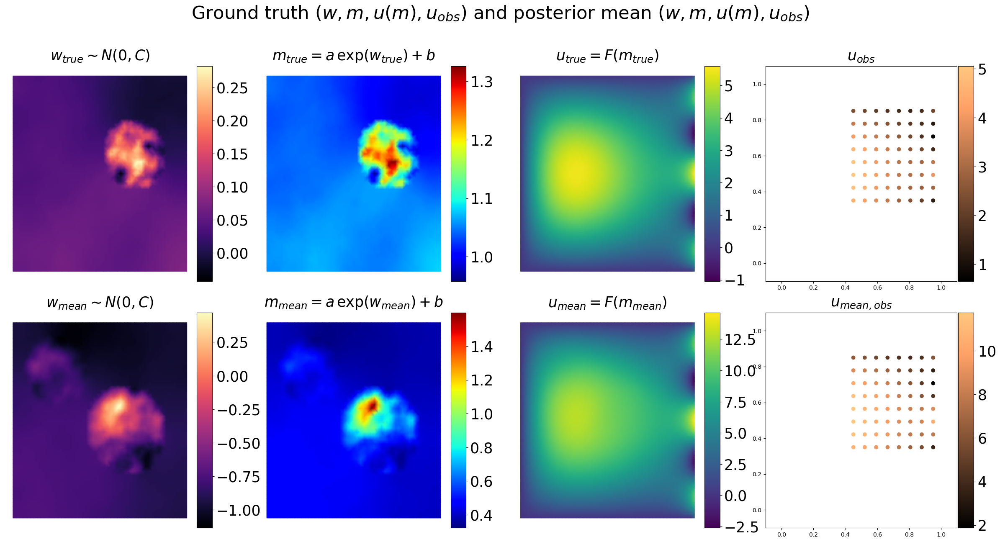

--------------------------------------------------
Sample: 1400, Accepted samples:   23, Acceptance Rate: 1.643e-02, Cost mean: 5.409e+05. 
Walking 50 number of samples took 2.105e+01s
--------------------------------------------------


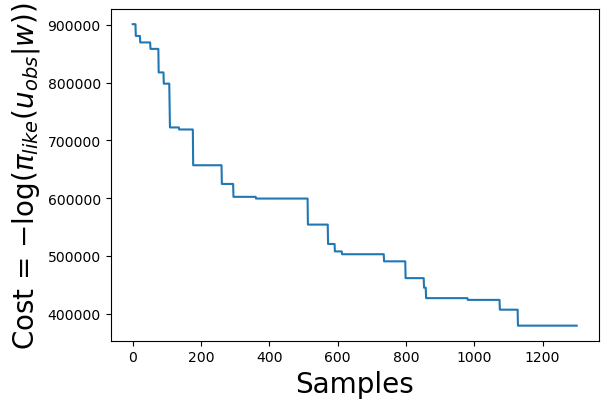

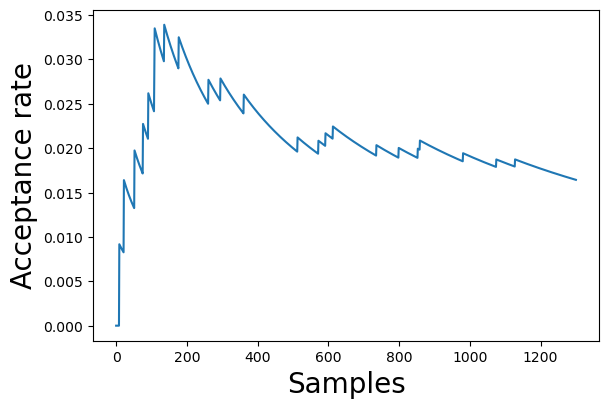

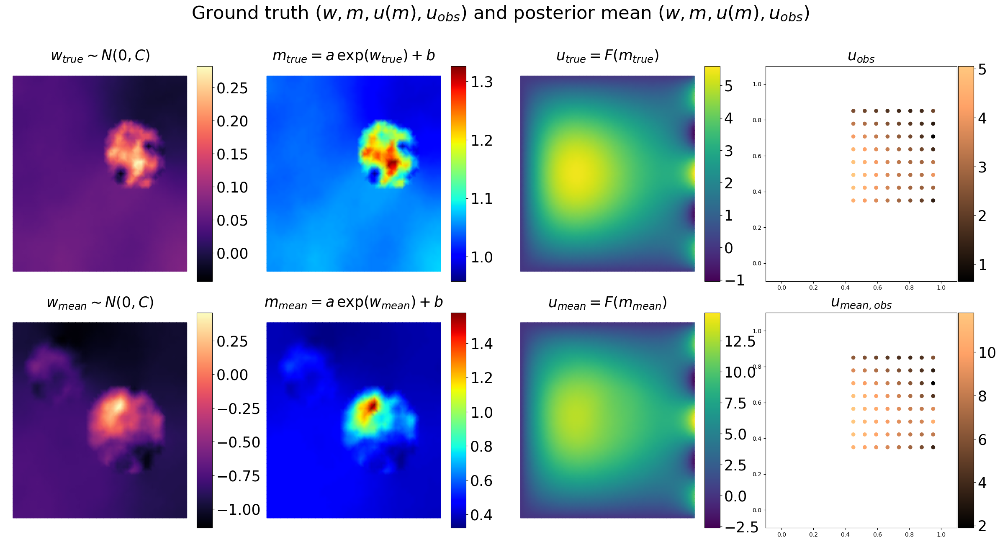

--------------------------------------------------
Sample: 1450, Accepted samples:   23, Acceptance Rate: 1.586e-02, Cost mean: 5.349e+05. 
Walking 50 number of samples took 2.219e+01s
--------------------------------------------------


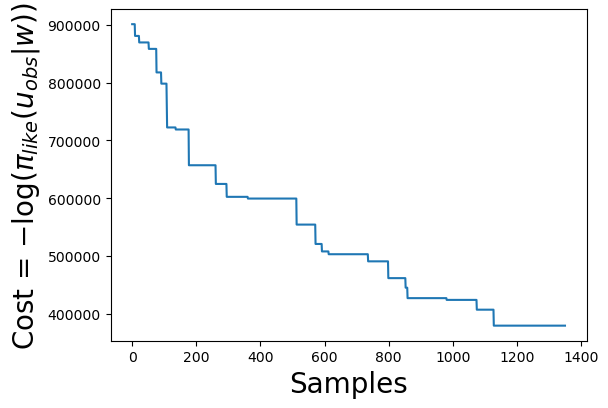

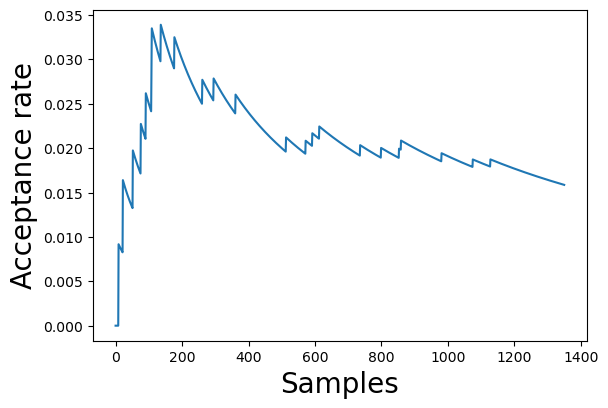

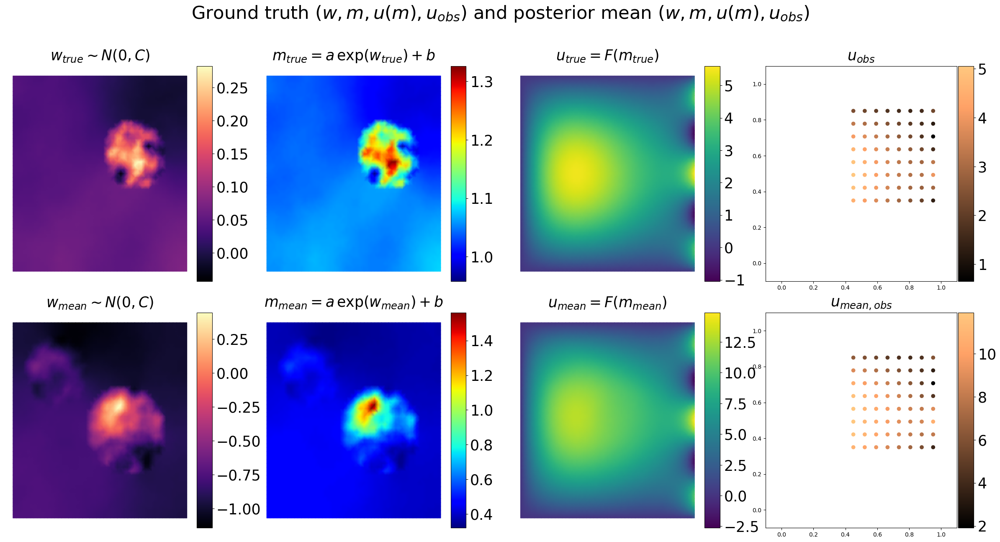

--------------------------------------------------
Sample: 1500, Accepted samples:   23, Acceptance Rate: 1.533e-02, Cost mean: 5.293e+05. 
Walking 50 number of samples took 2.030e+01s
--------------------------------------------------


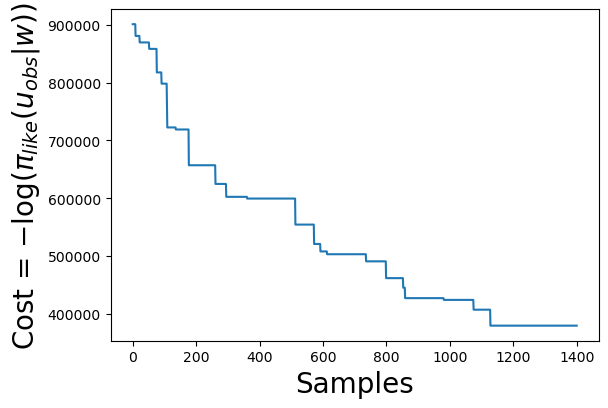

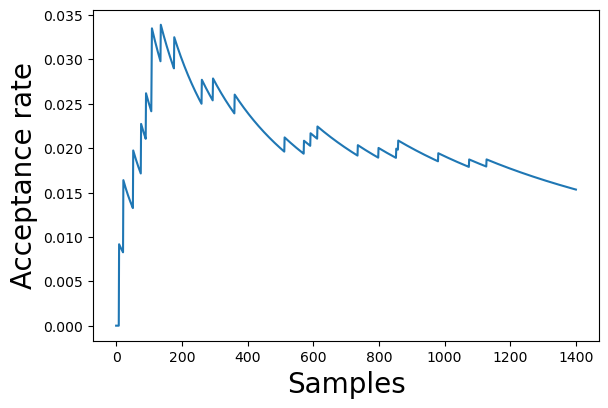

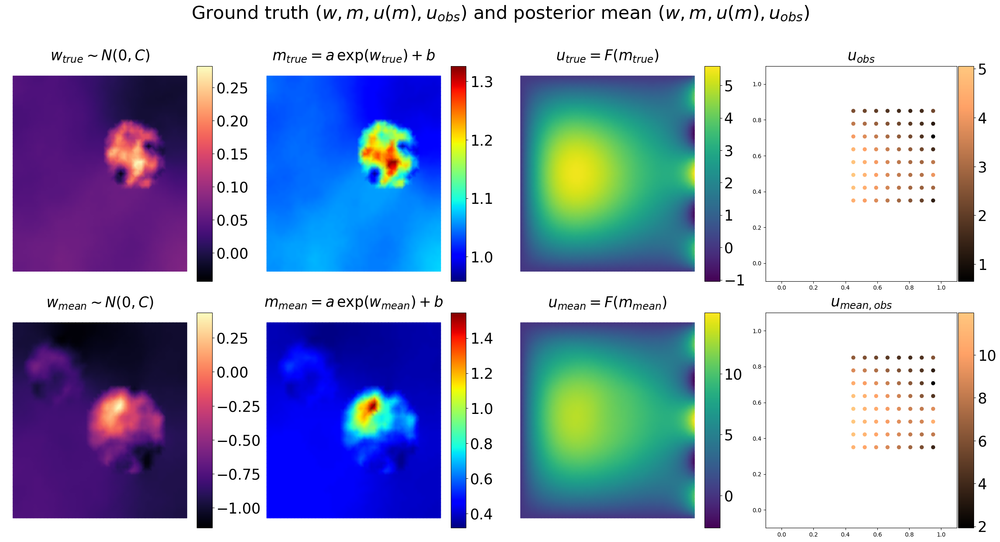

KeyboardInterrupt: 

In [117]:
n_samples = 4000
n_burnin = 100
pcn_beta = 0.45
display_plot_every = 50

if mcmc.surrogate_to_use is not None:
    savepath = results_dir + 'mcmc_results_n_samples_{:4d}_n_burnin_{:4d}_pcn_beta_{:.3f}_sigma_{:.3e}.npz'.format(n_samples, n_burnin, pcn_beta, sigma_noise) + '_surrogate_{}/'.format(mcmc.surrogate_to_use)
else:
    savepath = results_dir + 'mcmc_results_n_samples_{:4d}_n_burnin_{:4d}_pcn_beta_{:.3f}_sigma_{:.3e}.npz'.format(n_samples, n_burnin, pcn_beta, sigma_noise) + '/'

os.makedirs(savepath, exist_ok = True)

savefilename = 'tracer.npz'

mcmc.run(n_samples = n_samples, n_burnin = n_burnin, \
         pcn_beta = pcn_beta, sigma_noise = sigma_noise, \
         print_every = 50, print_lvl = 2, \
         display_plot_every = display_plot_every, \
         savefilename = savefilename, savepath = savepath)

In [83]:
mcmc.tracer.accepted_samples_cost.shape

(4002,)

# Plotting

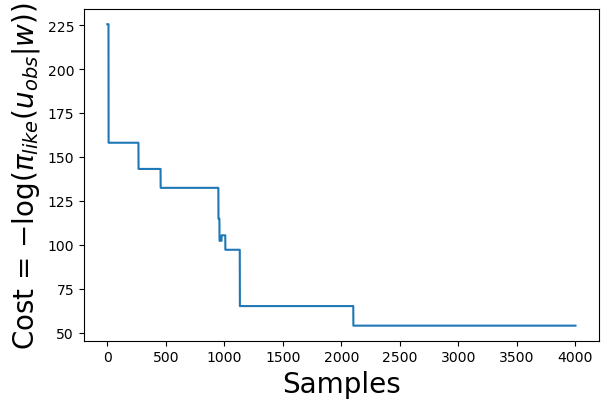

In [95]:
savefig = False
plot_curve(mcmc.tracer.accepted_samples_cost, xl=r'Samples', \
        yl= r'Cost = $-\log(\pi_{like}(u_{obs} | w))$', \
        fs = 20, lw = 3, \
        savefig = savefig, figsize=[6,4])

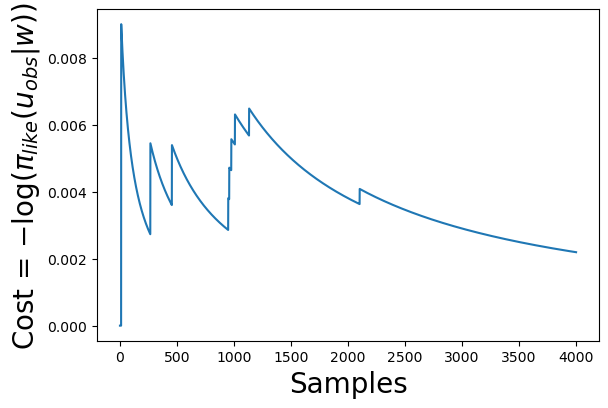

In [96]:
savefig = False
plot_curve(mcmc.tracer.acceptance_rate, xl=r'Samples', \
        yl= r'Cost = $-\log(\pi_{like}(u_{obs} | w))$', \
        fs = 20, lw = 3, \
        savefig = savefig, figsize=[6,4])

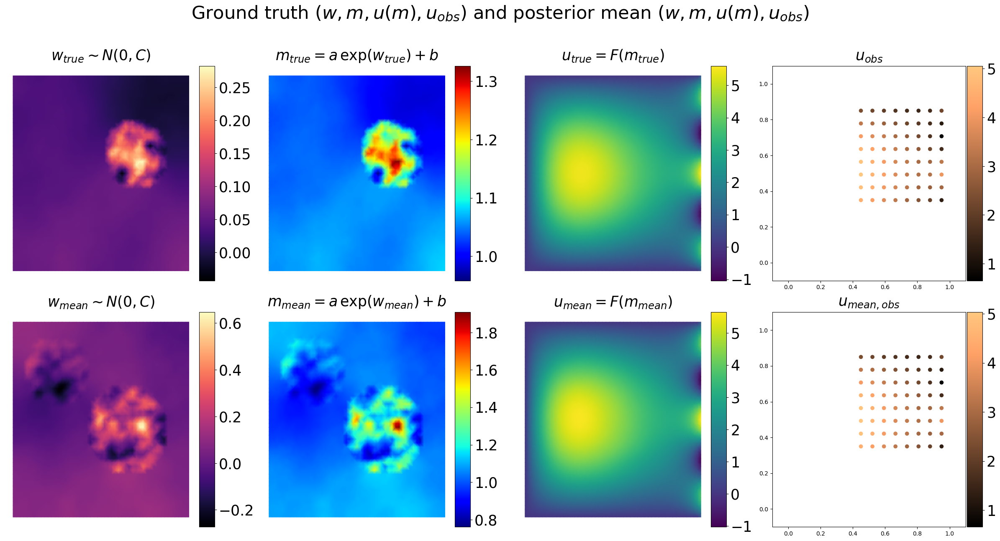

In [97]:
plot_fields(mcmc)

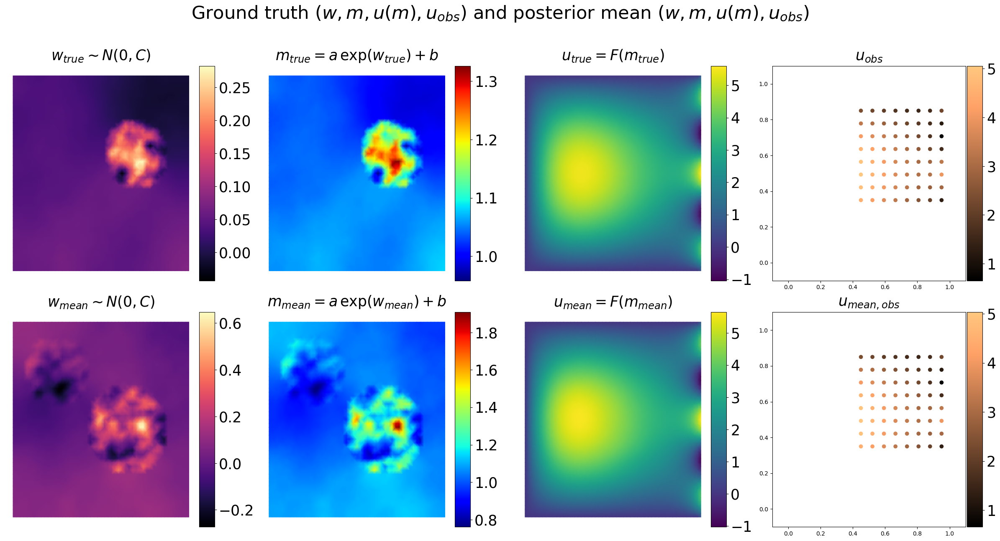

In [98]:
w_mean = mcmc.tracer.accepted_samples_mean_m
m_mean = model.transform_gaussian_pointwise(w_mean)
u_mean = model.solveFwd(u = None, m = m_mean, transform_m = False)

u_mean_obs = mcmc.state_to_obs(u_mean)

w_true, m_true, u_true = ground_truth_data['w_true'], ground_truth_data['m_true'], ground_truth_data['u_true'] 
u_obs = ground_truth_data['u_obs']

rows, cols = 2, 4
fig, axs = plt.subplots(rows, cols, figsize=(24, 12))
axs = np.array([axs]) if rows == 1 else axs

uvec = [[w_true, m_true, u_true], \
        [w_mean, m_mean, u_mean]]
title_vec = [[r'$w_{true} \sim N(0, C)$', r'$m_{true} = a\, \exp(w_{true}) + b$', r'$u_{true} = F(m_{true})$', r'$u_{obs}$'], \
             [r'$w_{mean} \sim N(0, C)$', r'$m_{mean} = a\, \exp(w_{mean}) + b$', r'$u_{mean} = F(m_{mean})$', r'$u_{mean, obs}$']]
cmap_vec = [['magma', 'jet', 'viridis', 'copper'] for i in range(rows)]
sup_title = r'Ground truth $(w, m, u(m), u_{obs})$ and posterior mean $(w, m, u(m), u_{obs})$'
fs = 25
y_sup_title = 1.075
savefilename = results_dir + 'true_and_posterior_mean_w_m_u.png'

nodes = model.Vm.mesh().coordinates()


for i in range(rows):
    for j in range(cols):

        # add grid points
        if j == cols - 1:
            axs[i,j].set_xlim([-0.1, 1.1])
            axs[i,j].set_ylim([-0.1, 1.1])
        
        if j < cols - 1:
            cbar = field_plot(axs[i,j], \
                uvec[i][j], \
                nodes, cmap = cmap_vec[i][j])
        else:
            uob = u_obs if i == 0 else u_mean_obs
            cbar = point_plot(axs[i,j], uob, x_obs, cmap = cmap_vec[i][j])
        divider = make_axes_locatable(axs[i,j])
        cax = divider.append_axes('right', size='8%', pad=0.03)
        cax.tick_params(labelsize=fs)
        cbar = fig.colorbar(cbar, cax=cax, orientation='vertical')
        if j < cols - 1:
            axs[i,j].axis('off')
        if title_vec is not None:
            axs[i,j].set_title(title_vec[i][j], fontsize=fs, pad=10)        

fig.tight_layout()
if sup_title is not None:
    fig.suptitle(sup_title, fontsize=1.25*fs, y = y_sup_title)
if savefilename is not None:
    plt.savefig(savefilename,  bbox_inches='tight')
plt.show()